## Lab 4 - Analyzing Real Estate Data in St. Petersburg
We have data from Yandex.Realty classified https://realty.yandex.ru containing real estate listings for apartments in St. Petersburg and Leningrad Oblast from 2016 till the middle of August 2018. In this Lab you'll learn how to work with datasets in python using pandas library for data analysis using the provided data. 
For datasets like this it becomes hard to use Excel because of its size. If you learn how to work with pandas you'll be able to do basic analytical research much faster than in Excel.
To execute code IPython notebook click on the Cell and press Shift-Enter.
If you don't have any experience with Jupyter notebooks, please look at this tutorial: https://mybinder.org/v2/gh/ipython/ipython-in-depth/master?filepath=binder/Index.ipynb

### Main objectives
After successful completion of the lab work students will be able to:
-	Analyze large datasets that don't work well in Excel using IPython notebook and pandas library
-   Find outliers and remove them in the datasets
-	Calculate different statistics on data fields


### Tasks
-	Calculate median and mean sell and rent prices in St. Petersburg
-   Find outliers: too cheap or too expensive apartments which seem to be a wrong data. Remove them from the dataset.
-	Find houses with the most cheapest and most expensive prices per square meter.
-   Analyze how many rent offers have the commission and what is the most popular commission



In [1]:
# let's import pandas library and set options to be able to view data right in the browser
# Assign pd for a short alias for pandas library
import pandas as pd
# Call set_option function fron pandas library to edit them limit for number of the displayed
# columns, width of all columns and maximum width of one column
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
pd.set_option('display.max_colwidth', 1000)

In [2]:
# let's look what is inside our data file to understand how we can export it. 
# We can use linux command "head" which shows the first row in the file. 
# In IPython notebooks you can execute linux commands using "!" prefixe before the command name. 
# This mechanism is called "IPython magic"
!head -n 3 spb.real.estate.archive.2018.tsv

offer_id	first_day_exposition	last_day_exposition	last_price	floor	open_plan	rooms	studio	area	kitchen_area	living_area	agent_fee	renovation	offer_type	category_type	unified_address	building_id
5490504238877583424	2014-11-27T00:00:00+03:00	2016-03-14T00:00:00+03:00	3676740.0	19	False	1	False	27.4	16.56	16.56		0.0	1	2	Россия, Санкт-Петербург, улица Шкапина, 9-11	3552413344225333068
5490504238903444021	2014-11-27T00:00:00+03:00	2016-04-28T00:00:00+03:00	7038880.0	2	False	3	False	85.84	19.64	41.2		0.0	1	2	Россия, Санкт-Петербург, Кушелевская дорога, 3к4	7274736308217971906


In [3]:
# if you don't remember what linux command does (i.e. what is -n), you can always look for help
!head --help

head: unrecognized option `--help'
usage: head [-n lines | -c bytes] [file ...]


In [4]:
!ls

ML_model_BakaletsD.ipynb
ML_model_BakaletsD.md
README-Copy1.md
README-draft.md
README.md
catboost_info
cleaned_dataset.csv
lab1_1_EDA_real_estate_data.ipynb
lab1_2_predict_house_price_visualization.ipynb
lab1_EDA_viz_BakaletsDaria-Copy1.ipynb
lab1_EDA_viz_BakaletsDaria-Copy1.md
lab1_EDA_viz_BakaletsDaria.ipynb
lab2_building_model (1).ipynb
lab2_building_model.ipynb
lab2_building_model_BakaletsDaria-2.ipynb
lab2_building_model_BakaletsDaria.ipynb
lab2_building_model_BakaletsDaria.md
lab2_building_model_example-Copy1.ipynb
lab2_building_model_example.ipynb
output_105_1.png
output_80_1.png
output_92_1.png
output_94_1.png
spb.real.estate.archive.2018.tsv
spb.real.estate.archive.sample5000.tsv


In [5]:
# we see that it's tab separated file, we can load it with pd.read_table method
# load our dataset and see which data it contains.
# HINT: you can type 'Tab' after starting typing the filename and IPython will automatically fill it for you
# After this command a new variable will be created (spb_df) containing pandas dataframe with data in our file
# You can think of dataframe structure as an analogue of Excel sheet
spb_df = pd.read_table('spb.real.estate.archive.2018.tsv')

In [6]:
# HINT: if you don't know which arguments any function takes or what it does you can check the documenation right 
# in the notebook just by adding "?" after the function name. Let's look at pandas read_table function:
#pd.read_table?

In [7]:
# let's check how much data in terms of rows we have where each row represent 
# one offer from Yandex.Realty
len(spb_df)

429187

In [8]:
# let's look at random sample of size 10 of the loaded dataset to understand what's inside
spb_df.sample(10)

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id
403215,5673813504758575617,2017-12-15T00:00:00+03:00,2018-08-20T00:00:00+03:00,4100000.0,6,False,2,False,60.4,9.2,38.8,NaN,2.0,1,2,"Россия, Санкт-Петербург, Пушкинский район, посёлок Шушары, Старорусский проспект, 6",7423300724866729798
182585,7816493083661826816,2017-06-08T00:00:00+03:00,2017-06-16T00:00:00+03:00,14000.0,3,False,2,False,41.0,5.0,22.0,60.0,3.0,2,2,"Россия, Санкт-Петербург, улица Лёни Голикова, 5",7534520496747056242
29980,2090950666896277869,2015-12-25T00:00:00+03:00,2016-03-11T00:00:00+03:00,1967100.0,13,False,1,False,24.0,NaN,17.0,NaN,0.0,1,2,"Россия, Санкт-Петербург, улица Бабушкина, 61",3629767610191609937
357773,8358933592541936416,2018-05-23T00:00:00+03:00,2018-08-20T00:00:00+03:00,5695386.0,10,False,1,False,40.9,11.6,18.2,NaN,NaN,1,2,"Россия, Санкт-Петербург, Свердловская набережная, 58",5164617829194191158
175912,1896730477199560937,2017-05-28T00:00:00+03:00,2017-05-29T00:00:00+03:00,36000.0,3,False,2,False,57.0,8.0,36.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Разъезжая улица, 15",5747076544150421374
57429,7600226447956480,2016-04-22T00:00:00+03:00,2016-05-05T00:00:00+03:00,15000.0,6,False,1,False,40.0,12.0,16.0,50.0,3.0,2,2,"Россия, Санкт-Петербург, Ленинский проспект, 55к2",1861668167106533340
225832,423813077597182464,2016-08-27T00:00:00+03:00,2018-02-08T00:00:00+03:00,3350000.0,2,False,1,False,34.0,7.0,17.0,NaN,2.0,1,2,"Россия, Санкт-Петербург, улица Ивана Фомина, 13к1",4540500922462421555
384466,7296089756633481562,2017-09-08T00:00:00+03:00,2018-07-18T00:00:00+03:00,35000.0,6,False,1,False,35.0,8.0,20.0,50.0,NaN,2,2,"Россия, Санкт-Петербург, Кронверкский проспект, 35",526949297145308076
306647,8623033408357152512,2018-03-12T00:00:00+03:00,2018-04-26T00:00:00+03:00,3300000.0,5,False,1,False,34.0,NaN,NaN,NaN,NaN,1,2,"Россия, Ленинградская область, Всеволожский район, посёлок городского типа Токсово, Привокзальная улица, 3",6949953929218172855
354028,4842857799862471955,2018-05-18T00:00:00+03:00,2018-07-27T00:00:00+03:00,85000.0,3,False,4,False,172.0,50.0,100.0,NaN,NaN,2,2,"Россия, Санкт-Петербург, Горная улица, 27",4316930820247319398


In [9]:
len(spb_df)

429187

In [10]:
spb_df.sample(5000).to_csv('spb.real.estate.archive.sample5000.tsv', index = False, sep='\t')

In [11]:
!pwd

/Users/dariabakalets/2_ML


### Analyze prices for rent and sell
We see that we have both RENT and SELL data. 
<p>offer_type column contains data to distinct them, 2 stands for RENT, 1 for SELL


#### Analyze rent prices

In [12]:
# at first let's split our dataframe to rent and sell
# Select some part of dataframe according to conditions in brackets
rent_df = spb_df[spb_df.offer_type == 2]
sell_df = spb_df[spb_df.offer_type == 1]
# .format function allows you to put variales' values instead of {} in the final string
print("Total rent data size: {}".format(len(rent_df)))
print("Total sell data size: {}".format(len(sell_df)))

Total rent data size: 171186
Total sell data size: 258001


In [13]:
# let's check median and price for renting apartments
# .last_price indicates that you use data just from the column named last_price
rent_median_price = rent_df.last_price.median()
rent_mean_price = rent_df.last_price.mean()
print("Rent median price: {}".format(rent_median_price))
print("Rent mean price: {}".format(rent_mean_price))

Rent median price: 25000.0
Rent mean price: 31719.256638977487


In [14]:
# Just to look at data of one column you can select this column. 
# 'head' function will take only first rows 
rent_df.last_price.head(10)

1086    20000.0
1096    40000.0
1097    45000.0
1149    21000.0
1514    25000.0
1515    35000.0
1516    22000.0
1537    20000.0
1555    26000.0
1695    25000.0
Name: last_price, dtype: float64

In [15]:
rent_df.describe()

,offer_id,last_price,floor,rooms,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,building_id
count,1.711860e+05,1.711860e+05,171186.000000,171186.000000,171186.000000,126875.000000,133280.000000,133188.000000,112603.000000,171186.0,171186.0,1.711860e+05
mean,4.667355e+18,3.171926e+04,6.793727,1.557890,52.455625,11.560852,30.027255,70.701652,3.864542,2.0,2.0,4.567898e+18
std,2.655929e+18,4.249697e+04,5.058804,0.886736,24.417140,79.465616,17.411222,28.828281,4.526333,0.0,0.0,2.699256e+18
min,8.726400e+05,1.300000e+02,1.000000,0.000000,11.000000,2.000000,2.000000,0.000000,0.000000,2.0,2.0,4.585730e+14
25%,2.599546e+18,2.000000e+04,3.000000,1.000000,36.000000,8.000000,18.000000,50.000000,0.000000,2.0,2.0,2.153540e+18
50%,5.141797e+18,2.500000e+04,5.000000,1.000000,45.000000,10.000000,26.000000,70.000000,2.000000,2.0,2.0,4.661483e+18
75%,6.867951e+18,3.500000e+04,9.000000,2.000000,60.000000,12.000000,36.000000,100.000000,10.000000,2.0,2.0,6.845097e+18
max,9.223288e+18,4.900000e+06,92.000000,5.000000,200.000000,25000.000000,2015.000000,100.000000,11.000000,2.0,2.0,9.220595e+18


#### Let's look at the most expensive apartments in rent

In [16]:
# .max function returns the maximum value across all rows
max_price_rent = rent_df.last_price.max()

In [17]:
print("Max price in rent: {}".format(max_price_rent))

Max price in rent: 4900000.0


In [18]:
# Now select all offers where price is equal to maximum value across all rent prices
rent_df_max = rent_df[rent_df.last_price == max_price_rent]

In [19]:
rent_df_max

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id
123675,5594900220237251840,2017-01-16T00:00:00+03:00,2017-01-16T00:00:00+03:00,4900000.0,3,False,3,False,55.4,5.5,42.1,NaN,0.0,2,2,"Россия, Санкт-Петербург, Новочеркасский проспект, 36",7844665691371923607


We can see that it was probably a mistake. It's hard to imagine why an aparment could cost 4.9 mln rubles per month. To analyze it let's look at the random sample of rent offers with prices of more than 1 mln rubles.

In [20]:
# Knowing real estate market in St.Petersburg we understand 
# that offers with rent prices over 1 million rubles are outliers
outliers_rent = rent_df[rent_df.last_price > 1000000]
print("Number of outliers in rent: {}".format(len(outliers_rent)))

Number of outliers in rent: 22


In [21]:
outliers_rent.sample(5)

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id
38416,5340729,2016-02-08T00:00:00+03:00,2016-02-15T00:00:00+03:00,2550000.0,8,False,1,False,38.0,6.0,19.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Варшавская улица, 51к1",6532707473577967135
29410,4944609,2015-12-23T00:00:00+03:00,2016-05-10T00:00:00+03:00,2250000.0,4,False,1,False,35.0,9.0,17.0,100.0,3.0,2,2,"Россия, Ленинградская область, Тосно, проспект Ленина, 27",4242058865805744796
306476,6589696843731071745,2018-03-12T00:00:00+03:00,2018-04-02T00:00:00+03:00,2500000.0,2,False,4,False,150.0,53.0,47.0,50.0,NaN,2,2,"Россия, Санкт-Петербург, Волховский переулок, 4",4642914072625498389
123675,5594900220237251840,2017-01-16T00:00:00+03:00,2017-01-16T00:00:00+03:00,4900000.0,3,False,3,False,55.4,5.5,42.1,NaN,0.0,2,2,"Россия, Санкт-Петербург, Новочеркасский проспект, 36",7844665691371923607
204049,7710633944129267457,2017-08-07T00:00:00+03:00,2017-11-07T00:00:00+03:00,4500000.0,7,False,1,False,63.1,16.1,23.4,NaN,0.0,2,2,"Россия, Санкт-Петербург, Колпино, улица Ижорского Батальона, 18",6064043689074707027


In [22]:
# We see that all of these offers are results of user mistakes.
# Pause to think what kind of mistakes might cause such numbers?
# Let's now look at rent offers below 1M but more than 500K

In [23]:
rent_df[(rent_df.last_price > 500000) & (rent_df.last_price < 1000000)]

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id
83621,6302977522903470578,2015-05-28T00:00:00+03:00,2017-04-26T00:00:00+03:00,550000.0,6,False,4,False,180.0,18.0,122.0,NaN,0.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к1",7861463534572863507
89836,6302977522901450489,2016-09-14T00:00:00+03:00,2016-09-15T00:00:00+03:00,800000.0,2,False,2,False,80.0,20.0,40.0,NaN,0.0,2,2,"Россия, Санкт-Петербург, Большая Морская улица, 27",8010764606439654926
106222,4377907628678297857,2016-11-07T00:00:00+03:00,2017-03-13T00:00:00+03:00,600000.0,6,False,4,False,187.0,NaN,127.0,100.0,1.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к1",7861463534572863507
172166,3376106655979657514,2017-02-24T00:00:00+03:00,2017-05-24T00:00:00+03:00,600000.0,6,False,4,False,200.0,NaN,103.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к2",7861463534572863508
172950,1896730477252952293,2016-10-31T00:00:00+03:00,2017-05-26T00:00:00+03:00,650000.0,6,False,4,False,190.0,20.0,102.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к1",7861463534572863507
253075,9174606537144832259,2017-11-16T00:00:00+03:00,2018-08-20T00:00:00+03:00,600000.0,1,False,4,False,165.0,NaN,115.0,NaN,6.0,2,2,"Россия, Санкт-Петербург, проспект Динамо, 6",135575281136523355
321216,2596865999798823681,2018-03-31T00:00:00+03:00,2018-04-04T00:00:00+03:00,575000.0,3,False,4,False,120.0,NaN,NaN,50.0,1.0,2,2,"Россия, Санкт-Петербург, Кременчугская улица, 17к3",9078299753075959719
323711,9106659135022232833,2018-04-03T00:00:00+03:00,2018-06-15T00:00:00+03:00,600000.0,1,False,4,False,90.0,13.0,54.0,0.0,11.0,2,2,"Россия, Санкт-Петербург, Большой Сампсониевский проспект, 33/1",192308642065385452
336616,8867625833179319559,2018-04-21T00:00:00+03:00,2018-08-09T00:00:00+03:00,600000.0,1,False,4,False,117.0,20.0,83.0,0.0,NaN,2,2,"Россия, Санкт-Петербург, проспект Динамо, 6",135575281136523355
419166,5152264856292210972,2018-02-01T00:00:00+03:00,2018-08-16T00:00:00+03:00,600000.0,1,False,4,False,140.0,95.0,100.0,100.0,NaN,2,2,"Россия, Санкт-Петербург, проспект Динамо, 6",135575281136523355


In [24]:
# for these cases sometimes it seems that the price is correct - in the unified_address column we
# see that these offers are from elite houses
# like here: https://realty.yandex.ru/archive/Россия%2C%20Санкт-Петербург%2C%20проспект%20Динамо%2C%206/snyat/kvartira/
# but for some of them price seems to be 10 times more than it should be, like here
# https://realty.yandex.ru/archive/Россия%2C%20Санкт-Петербург%2C%20Большая%20Морская%20улица%2C%2027/snyat/kvartira/
# let's find these cases

### Calculate price per square meter, get median prices for house and find outliers with the help of this

In [25]:
# Create a new column price_per_sq_m and calculate price per sq m
rent_df['price_per_sq_m'] = rent_df.last_price/rent_df.area

/var/folders/_9/hdzs3fj92gz4h7c3jw2hrc6m0000gn/T/ipykernel_42767/816257644.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rent_df['price_per_sq_m'] = rent_df.last_price/rent_df.area


In [26]:
rent_df.head(5)

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m
1086,1100202,2015-01-24T00:00:00+03:00,2016-01-19T00:00:00+03:00,20000.0,7,False,1,False,28.0,8.0,20.0,100.0,3.0,2,2,"Россия, Санкт-Петербург, Богатырский проспект, 5к1",6719200042030752141,714.285714
1096,5028522699704970725,2015-01-25T00:00:00+03:00,2016-01-20T00:00:00+03:00,40000.0,4,False,2,False,72.0,10.0,44.0,NaN,0.0,2,2,"Россия, Санкт-Петербург, набережная реки Фонтанки, 66",3406104650917898355,555.555556
1097,5028522699709767236,2015-01-25T00:00:00+03:00,2016-01-21T00:00:00+03:00,45000.0,2,False,2,False,55.0,NaN,33.0,NaN,0.0,2,2,"Россия, Санкт-Петербург, Большой проспект П.С., 102",2357095685903407888,818.181818
1149,1100874,2015-01-28T00:00:00+03:00,2016-01-16T00:00:00+03:00,21000.0,5,False,1,False,35.0,8.0,18.0,NaN,11.0,2,2,"Россия, Санкт-Петербург, Лужская улица, 8",5887402119500981764,600.000000
1514,875413,2015-02-13T00:00:00+03:00,2016-01-23T00:00:00+03:00,25000.0,10,False,1,True,44.0,15.0,18.0,90.0,10.0,2,2,"Россия, Санкт-Петербург, Учительская улица, 3",6527910144166454997,568.181818


In [27]:
# find what's median and mean price per square meter in rent
median_price_per_sq_m = rent_df.price_per_sq_m.median()
mean_price_per_sq_m = rent_df.price_per_sq_m.mean()
print("Median price per sq m in rent: {}".format(median_price_per_sq_m))
print("Mean price per sq m in rent: {}".format(mean_price_per_sq_m))

Median price per sq m in rent: 550.0
Mean price per sq m in rent: 600.1110692967957


#### Find median price per sq m per house

In [28]:
# .groupby function groups dataframe by a selected column (unified_address)
# For each address we then take a median of price per sq m and return a new dataframe 
# with a result
house_rent_df = rent_df.groupby('unified_address').price_per_sq_m.median().reset_index()

In [29]:
house_rent_df.head(5)

,unified_address,price_per_sq_m
0,"Россия, Ленинградская область, Бокситогорск, Комсомольская улица, 5А",171.428571
1,"Россия, Ленинградская область, Бокситогорск, Южная улица, 15",250.000000
2,"Россия, Ленинградская область, Бокситогорск, улица Металлургов, 7",164.948454
3,"Россия, Ленинградская область, Бокситогорск, улица Павлова, 37",138.888889
4,"Россия, Ленинградская область, Бокситогорский район, Пикалёво, 6-й микрорайон, 25",195.652174


In [30]:
# Rename the column with a 'rename' function in this new dataframe
house_rent_df.rename(columns = {'price_per_sq_m': 'house_price_sqm_median'}, inplace = True)

#### Merge rent data with house median prices and inspect outliers

In [31]:
# With a 'merge' function join two dataframes.
# As these 2 dataframes have only one common column name (unified_address) it will merge dataframes by it
rent_df = rent_df.merge(house_rent_df)

In [32]:
# Assign outliers if price per sq m is 5 times higher than the median value in the house
outliers = rent_df[(rent_df.price_per_sq_m/rent_df.house_price_sqm_median) > 5]

In [33]:
print(len(outliers))

49


In [34]:
outliers.sample(10)

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
32281,7796157803399736832,2018-06-12T00:00:00+03:00,2018-07-12T00:00:00+03:00,150000.0,11,False,1,False,42.0,NaN,NaN,NaN,NaN,2,2,"Россия, Санкт-Петербург, Пулковское шоссе, 38к7",6690775821291644660,3571.428571,641.025641
15364,7445356856168407296,2017-09-23T00:00:00+03:00,2017-10-07T00:00:00+03:00,350000.0,3,False,3,False,89.0,15.0,54.0,NaN,10.0,2,2,"Россия, Санкт-Петербург, проспект Просвещения, 33к2",561327474932141599,3932.584270,543.040293
74207,6589696843731071745,2018-03-12T00:00:00+03:00,2018-04-02T00:00:00+03:00,2500000.0,2,False,4,False,150.0,53.0,47.0,50.0,NaN,2,2,"Россия, Санкт-Петербург, Волховский переулок, 4",4642914072625498389,16666.666667,887.850467
127383,8942884502653415424,2018-05-30T00:00:00+03:00,2018-05-30T00:00:00+03:00,160000.0,3,False,1,False,31.0,8.0,NaN,NaN,3.0,2,2,"Россия, Санкт-Петербург, улица Маяковского, 22-24",6625325292957601276,5161.290323,886.111111
109040,7710633944129267457,2017-08-07T00:00:00+03:00,2017-11-07T00:00:00+03:00,4500000.0,7,False,1,False,63.1,16.1,23.4,NaN,0.0,2,2,"Россия, Санкт-Петербург, Колпино, улица Ижорского Батальона, 18",6064043689074707027,71315.372425,397.674419
49571,5767886800803908609,2016-09-05T00:00:00+03:00,2016-09-20T00:00:00+03:00,220000.0,10,False,1,False,38.0,9.0,20.0,90.0,0.0,2,2,"Россия, Санкт-Петербург, Мартыновская улица, 14к1",2343343426282459044,5789.473684,579.796265
59229,5217254,2016-01-27T00:00:00+03:00,2016-02-03T00:00:00+03:00,3500000.0,9,False,1,False,31.9,8.7,16.2,NaN,3.0,2,2,"Россия, Санкт-Петербург, Будапештская улица, 38к4",5729094119176815453,109717.868339,545.454545
73297,5365373,2016-02-10T00:00:00+03:00,2016-02-17T00:00:00+03:00,180000.0,6,False,1,False,35.0,9.0,20.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, улица Крыленко, 19к1",4951256661585230565,5142.857143,562.500000
92508,2999393105455825921,2018-06-20T00:00:00+03:00,2018-07-10T00:00:00+03:00,300000.0,14,False,2,False,69.9,11.0,41.0,35.0,7.0,2,2,"Россия, Санкт-Петербург, Тимуровская улица, 23к3",6543106262045781175,4291.845494,550.000000
117317,8256452766188712792,2018-05-11T00:00:00+03:00,2018-08-20T00:00:00+03:00,400000.0,3,False,3,False,85.0,15.0,55.0,50.0,1.0,2,2,"Россия, Санкт-Петербург, Итальянская улица, 11",15264832366839851,4705.882353,933.333333


#### Clean data from the outliers

In [35]:
# Let's create a new dataframe with clean data.
# With ~ we can select the data which does NOT correspond to the required conditions
rent_df_cleaned = rent_df[~((rent_df.price_per_sq_m/rent_df.house_price_sqm_median) > 5)]

In [36]:
# check that in the middle segment everything is fine now
rent_df_cleaned[(rent_df_cleaned.last_price > 500000) & (rent_df_cleaned.last_price < 1000000)]

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
95391,3376106655979657514,2017-02-24T00:00:00+03:00,2017-05-24T00:00:00+03:00,600000.0,6,False,4,False,200.0,NaN,103.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к2",7861463534572863508,3000.000000,1385.501355
96070,6302977522903470578,2015-05-28T00:00:00+03:00,2017-04-26T00:00:00+03:00,550000.0,6,False,4,False,180.0,18.0,122.0,NaN,0.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к1",7861463534572863507,3055.555556,1442.307692
96075,4377907628678297857,2016-11-07T00:00:00+03:00,2017-03-13T00:00:00+03:00,600000.0,6,False,4,False,187.0,NaN,127.0,100.0,1.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к1",7861463534572863507,3208.556150,1442.307692
96091,1896730477252952293,2016-10-31T00:00:00+03:00,2017-05-26T00:00:00+03:00,650000.0,6,False,4,False,190.0,20.0,102.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к1",7861463534572863507,3421.052632,1442.307692
154614,9174606537144832259,2017-11-16T00:00:00+03:00,2018-08-20T00:00:00+03:00,600000.0,1,False,4,False,165.0,NaN,115.0,NaN,6.0,2,2,"Россия, Санкт-Петербург, проспект Динамо, 6",135575281136523355,3636.363636,3636.363636
154615,8867625833179319559,2018-04-21T00:00:00+03:00,2018-08-09T00:00:00+03:00,600000.0,1,False,4,False,117.0,20.0,83.0,0.0,NaN,2,2,"Россия, Санкт-Петербург, проспект Динамо, 6",135575281136523355,5128.205128,3636.363636
154617,5152264856292210972,2018-02-01T00:00:00+03:00,2018-08-16T00:00:00+03:00,600000.0,1,False,4,False,140.0,95.0,100.0,100.0,NaN,2,2,"Россия, Санкт-Петербург, проспект Динамо, 6",135575281136523355,4285.714286,3636.363636


In [37]:
# look at offers with price > 1 000 000
rent_df_cleaned[(rent_df_cleaned.last_price >= 1000000)]

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
67005,5199154,2016-01-25T00:00:00+03:00,2016-01-26T00:00:00+03:00,3800000.0,3,False,2,False,51.0,6.0,30.5,NaN,0.0,2,2,"Россия, Санкт-Петербург, Пискарёвский проспект, 149",7757194067653498771,74509.803922,74509.803922
95935,8743101202301731585,2016-10-13T00:00:00+03:00,2016-11-12T00:00:00+03:00,1500000.0,3,False,2,False,54.7,NaN,NaN,NaN,7.0,2,2,"Россия, Ленинградская область, Выборгский район, Светогорское городское поселение, поселок городского типа Лесогорский, улица Труда, 7",2755098623625145659,27422.303473,13811.700183
114024,4075481786711135488,2016-08-18T00:00:00+03:00,2016-08-18T00:00:00+03:00,3500000.0,1,False,2,False,55.0,8.3,30.5,NaN,3.0,2,2,"Россия, Ленинградская область, Всеволожск, микрорайон Южный, Центральная улица, 13",4521154714631889065,63636.363636,63636.363636
164662,4088017598264857345,2018-02-09T00:00:00+03:00,2018-03-21T00:00:00+03:00,1330000.0,3,False,1,False,33.0,6.0,19.0,NaN,3.0,2,2,"Россия, Ленинградская область, Луга, проспект Урицкого, 65",1792010144615909485,40303.030303,40303.030303


In [38]:
# we see, that all of them are outliers, they were not cleaned by the house price per sq m median 
# because it was the only one or just one of two offers per house
# let's clean them also
# Store result in the same dataframe
rent_df_cleaned = rent_df_cleaned[rent_df_cleaned.last_price < 1000000]

In [39]:
# let's examine apartments with big price per sq m
rent_df_cleaned[rent_df_cleaned.price_per_sq_m > 3000]

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
549,8596035942924139265,2018-05-17T00:00:00+03:00,2018-07-04T00:00:00+03:00,450000.0,6,False,2,False,106.0,15.0,65.0,30.0,NaN,2,2,"Россия, Санкт-Петербург, Воскресенская набережная, 4",7262659557693263963,4245.283019,975.609756
28182,1492050389917501301,2017-06-07T00:00:00+03:00,2017-06-07T00:00:00+03:00,195000.0,4,False,1,False,57.0,8.0,19.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, проспект Добролюбова, 2",6684242979485775735,3421.052632,779.220779
39213,3793550987719225600,2017-03-19T00:00:00+03:00,2017-11-02T00:00:00+03:00,310000.0,3,False,4,False,100.0,14.0,71.0,100.0,1.0,2,2,"Россия, Санкт-Петербург, Лиговский проспект, 123",2861706125080798064,3100.000000,976.307190
44574,1896730477284436579,2017-05-31T00:00:00+03:00,2017-05-31T00:00:00+03:00,230000.0,9,False,2,False,67.0,14.0,30.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Глухая Зеленина улица, 6",6445545084936583797,3432.835821,923.076923
96070,6302977522903470578,2015-05-28T00:00:00+03:00,2017-04-26T00:00:00+03:00,550000.0,6,False,4,False,180.0,18.0,122.0,NaN,0.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к1",7861463534572863507,3055.555556,1442.307692
96075,4377907628678297857,2016-11-07T00:00:00+03:00,2017-03-13T00:00:00+03:00,600000.0,6,False,4,False,187.0,NaN,127.0,100.0,1.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к1",7861463534572863507,3208.556150,1442.307692
96091,1896730477252952293,2016-10-31T00:00:00+03:00,2017-05-26T00:00:00+03:00,650000.0,6,False,4,False,190.0,20.0,102.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к1",7861463534572863507,3421.052632,1442.307692
99409,7102677476104578816,2016-05-20T00:00:00+03:00,2016-05-20T00:00:00+03:00,270000.0,1,False,1,False,80.0,NaN,NaN,0.0,3.0,2,2,"Россия, Санкт-Петербург, Загородный проспект, 5",8810747501928407960,3375.000000,1978.197674
104668,159653575951184384,2016-06-16T00:00:00+03:00,2016-07-01T00:00:00+03:00,300000.0,2,False,3,False,54.0,8.0,35.0,50.0,11.0,2,2,"Россия, Санкт-Петербург, 18-я линия В.О., 43",6003296125598219505,5555.555556,5555.555556
150701,1492050390917641037,2016-10-28T00:00:00+03:00,2017-06-07T00:00:00+03:00,400000.0,4,False,3,False,130.0,13.0,85.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Константиновский проспект, 23",5091810811209082905,3076.923077,3484.848485


In [40]:
# we can see that outliers are those which are in houses with price per sq m below 1000 rubles, 
# and those which are the same with median, in which case it's the only offer per house
outliers_count = len(rent_df_cleaned[(rent_df_cleaned.price_per_sq_m > 3000) 
                                     & ((rent_df_cleaned.house_price_sqm_median < 1000) 
                                        | (rent_df_cleaned.house_price_sqm_median == rent_df_cleaned.price_per_sq_m))])
print("outliers found: {}".format(outliers_count))
rent_df_cleaned = rent_df_cleaned[~((rent_df_cleaned.price_per_sq_m > 3000) 
                                     & ((rent_df_cleaned.house_price_sqm_median < 1000) 
                                        | (rent_df_cleaned.house_price_sqm_median == rent_df_cleaned.price_per_sq_m)))]

outliers found: 8


In [41]:
# now max price should be correct, lets look at this offer
max_rent_apartment = rent_df_cleaned[rent_df_cleaned.last_price == rent_df_cleaned.last_price.max()]
max_rent_apartment

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
96091,1896730477252952293,2016-10-31T00:00:00+03:00,2017-05-26T00:00:00+03:00,650000.0,6,False,4,False,190.0,20.0,102.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Парадная улица, 3к1",7861463534572863507,3421.052632,1442.307692


In [42]:
# let's look at house address. 
# with 'iloc' property we can take any row by index, 
# in this case we take the first item to get the address
max_rent_apartment.unified_address.iloc[0]

'Россия, Санкт-Петербург, Парадная улица, 3к1'

In [43]:
# impoort urllib to prepare correct URLs for looking at offers archive 
# at https://realty.yandex.ru/archive
import urllib

In [44]:
# if you're interested in images of this apartment you can find it here: 
# https://realty.yandex.ru/archive/Россия%2C%20Санкт-Петербург%2C%20Парадная%20улица%2C%203к1/snyat/kvartira/2/?roomsTotal=4

# let's print the URL of the page, on which we can find our offer
# we use urllib.parse.quote function to get URL part from our address, otherwise URL wouldn't be correct
# print("https://realty.yandex.ru/archive/{}/snyat/kvartira/2/?roomsTotal=4".format(urllib.parse.quote(max_rent_apartment.unified_address.iloc[0])))
# print("https://realty.yandex.ru/otsenka-kvartiry-po-adresu-onlayn/{}/snyat/kvartira/?roomsTotal=4".format(urllib.parse.quote(max_rent_apartment.unified_address.iloc[0])))
print("https://realty.yandex.ru/otsenka-kvartiry-po-adresu-onlayn/{}/snyat/kvartira/".format(urllib.parse.quote(max_rent_apartment.unified_address.iloc[0])))
# use filters there to select only apartments with 4 rooms

https://realty.yandex.ru/otsenka-kvartiry-po-adresu-onlayn/%D0%A0%D0%BE%D1%81%D1%81%D0%B8%D1%8F%2C%20%D0%A1%D0%B0%D0%BD%D0%BA%D1%82-%D0%9F%D0%B5%D1%82%D0%B5%D1%80%D0%B1%D1%83%D1%80%D0%B3%2C%20%D0%9F%D0%B0%D1%80%D0%B0%D0%B4%D0%BD%D0%B0%D1%8F%20%D1%83%D0%BB%D0%B8%D1%86%D0%B0%2C%203%D0%BA1/snyat/kvartira/


### Find houses with the most cheapest and the most expensive rent price

In [45]:
# Create a new dataframe with houses and median price per sq m
# This time it should with the data calculated without outliers
house_rent_df_cleaned = rent_df_cleaned.groupby('unified_address').price_per_sq_m.median().reset_index()
house_rent_df_cleaned.rename(columns = {'price_per_sq_m': 'house_price_sqm_median_cleaned'}, inplace = True)

In [46]:
most_expensive_house = house_rent_df_cleaned[house_rent_df_cleaned.house_price_sqm_median_cleaned == house_rent_df_cleaned.house_price_sqm_median_cleaned.max()]
most_expensive_house

,unified_address,house_price_sqm_median_cleaned
16851,"Россия, Санкт-Петербург, проспект Динамо, 6",3705.357143


In [47]:
# you can look at the most expensive house here
# https://realty.yandex.ru/archive/Россия%2C%20Санкт-Петербург%2C%20проспект%20Динамо%2C%206/snyat/kvartira/
print("https://realty.yandex.ru/archive/{}/snyat/kvartira/".format(urllib.parse.quote(most_expensive_house.unified_address.iloc[0])))

https://realty.yandex.ru/archive/%D0%A0%D0%BE%D1%81%D1%81%D0%B8%D1%8F%2C%20%D0%A1%D0%B0%D0%BD%D0%BA%D1%82-%D0%9F%D0%B5%D1%82%D0%B5%D1%80%D0%B1%D1%83%D1%80%D0%B3%2C%20%D0%BF%D1%80%D0%BE%D1%81%D0%BF%D0%B5%D0%BA%D1%82%20%D0%94%D0%B8%D0%BD%D0%B0%D0%BC%D0%BE%2C%206/snyat/kvartira/


#### Find the most cheapest house for rent

In [48]:
most_cheapest_house = house_rent_df_cleaned[house_rent_df_cleaned.house_price_sqm_median_cleaned == house_rent_df_cleaned.house_price_sqm_median_cleaned.min()]
most_cheapest_house

,unified_address,house_price_sqm_median_cleaned
2421,"Россия, Ленинградская область, Кириши, улица Мира, 14",50.0


In [49]:
# we see that it's located in Leningrad Oblast, let's look only in St. Petersburg data
house_rent_df_cleaned_spb = house_rent_df_cleaned[house_rent_df_cleaned.unified_address.str.contains('Россия, Санкт-Петербург')]
house_rent_df_cleaned_spb[house_rent_df_cleaned_spb.house_price_sqm_median_cleaned == house_rent_df_cleaned_spb.house_price_sqm_median_cleaned.min()]

,unified_address,house_price_sqm_median_cleaned
4852,"Россия, Санкт-Петербург, Большая Зеленина улица, 12",76.923077


#### Clean cheap outliers
We see that we should clean the data, the cheapest house above is definitely a mistake, and it is an underground station building. You can check it at https://maps.yandex.ru

In [50]:
# consider only data inside the city without oblast
rent_df_cleaned_spb = rent_df_cleaned[rent_df_cleaned.unified_address.str.contains('Россия, Санкт-Петербург')]
median_price_per_sq_m_in_spb = rent_df_cleaned_spb.price_per_sq_m.median()
print("Median price per sq m in St. Petersburg in rent: {}".format(median_price_per_sq_m_in_spb))

Median price per sq m in St. Petersburg in rent: 555.5555555555555


In [51]:
# look at cheap apartments which are more than two times cheaper 
# than the median value of offers we calculated above (555)
rent_df_cleaned_spb[rent_df_cleaned_spb.price_per_sq_m < 250].sample(10)

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
154465,5505607014130099713,2018-02-24T00:00:00+03:00,2018-03-09T00:00:00+03:00,17000.0,7,False,3,False,78.0,13.0,54.0,40.0,3.0,2,2,"Россия, Санкт-Петербург, Пушкинский район, посёлок Шушары, территория Славянка, Колпинское шоссе, 34к2",7936294240150898964,217.948718,320.000000
73246,8703508311489187328,2016-07-24T00:00:00+03:00,2016-08-02T00:00:00+03:00,16000.0,6,False,3,False,80.0,8.0,43.0,50.0,3.0,2,2,"Россия, Санкт-Петербург, Пушкинский район, посёлок Шушары, Колпинское шоссе, 40",7452048126409559335,200.000000,377.777778
81076,5565310413833310391,2018-05-30T00:00:00+03:00,2018-06-06T00:00:00+03:00,27000.0,4,False,0,True,112.0,NaN,NaN,100.0,NaN,2,2,"Россия, Санкт-Петербург, проспект Авиаконструкторов, 45к1",6175835586918873183,241.071429,400.000000
120849,3085977058366757121,2017-12-07T00:00:00+03:00,2017-12-08T00:00:00+03:00,17000.0,9,False,2,False,70.0,NaN,NaN,NaN,3.0,2,2,"Россия, Санкт-Петербург, Пушкинский район, посёлок Шушары, территория Славянка, Ростовская улица, 14-16",4153179922410625475,242.857143,264.912281
106615,3653332947260070401,2016-07-01T00:00:00+03:00,2016-07-08T00:00:00+03:00,11000.0,3,False,2,False,71.0,9.0,42.0,50.0,3.0,2,2,"Россия, Санкт-Петербург, Красное Село, Нагорная улица, 37",4011485438398100794,154.929577,183.098592
140775,4273146500661149184,2017-08-07T00:00:00+03:00,2017-08-14T00:00:00+03:00,18000.0,1,False,3,False,80.0,NaN,47.0,NaN,3.0,2,2,"Россия, Санкт-Петербург, Пушкинский район, посёлок Шушары, территория Славянка, Полоцкая улица, 3",1567817487054992611,225.000000,300.000000
101,8884398847122004736,2017-08-17T00:00:00+03:00,2017-08-20T00:00:00+03:00,15000.0,9,False,2,False,63.0,12.0,33.0,100.0,2.0,2,2,"Россия, Санкт-Петербург, Серебристый бульвар, 17к1",6737133099650332271,238.095238,561.224490
131538,3954506054109548544,2017-01-08T00:00:00+03:00,2017-01-14T00:00:00+03:00,16000.0,7,False,3,False,80.0,19.0,70.0,80.0,0.0,2,2,"Россия, Санкт-Петербург, Пушкинский район, посёлок Шушары, территория Славянка, Изборская улица, 3к1",7727526934365677155,200.000000,310.226493
59576,5286438614395986945,2018-06-11T00:00:00+03:00,2018-07-18T00:00:00+03:00,25000.0,9,False,3,False,173.0,9.5,44.0,50.0,3.0,2,2,"Россия, Санкт-Петербург, улица Буренина, 1к1",4124443507106774841,144.508671,470.884658
109039,8991364971733814017,2017-04-07T00:00:00+03:00,2017-04-14T00:00:00+03:00,20000.0,10,False,2,False,87.0,NaN,NaN,NaN,3.0,2,2,"Россия, Санкт-Петербург, Колпино, улица Ижорского Батальона, 18",6064043689074707027,229.885057,397.674419


In [52]:
# it seems that we should clean all apartments where median price is at least 2x higher and cheap 
outliers = rent_df_cleaned_spb[(rent_df_cleaned_spb.price_per_sq_m < 250) 
                               & (rent_df_cleaned_spb.house_price_sqm_median/rent_df_cleaned_spb.price_per_sq_m >= 2)]

In [53]:
print("number of cheap outliers 2x cheaper: {}".format(len(outliers)))

number of cheap outliers 2x cheaper: 100


In [54]:
# clean outliers
rent_df_cleaned_spb = rent_df_cleaned_spb[~((rent_df_cleaned_spb.price_per_sq_m < 250) 
                               & (rent_df_cleaned_spb.house_price_sqm_median/rent_df_cleaned_spb.price_per_sq_m >= 2))]

In [55]:
# look at cheap apartments which were not cleaned with the previous heuristics
rent_df_cleaned_spb[rent_df_cleaned_spb.price_per_sq_m < 200]

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
46867,4857633,2015-12-13T00:00:00+03:00,2016-06-05T00:00:00+03:00,12000.0,6,False,3,False,61.0,7.0,42.0,80.0,3.0,2,2,"Россия, Санкт-Петербург, Красное Село, Стрельнинское шоссе, 6к3",1523555400005784785,196.721311,256.578947
57861,4975278,2015-12-27T00:00:00+03:00,2016-01-12T00:00:00+03:00,13000.0,4,False,3,False,78.0,10.0,47.0,NaN,10.0,2,2,"Россия, Санкт-Петербург, 12-я Красноармейская улица, 7",6204918944542168630,166.666667,166.666667
80404,2939523434608526081,2018-03-06T00:00:00+03:00,2018-03-13T00:00:00+03:00,15000.0,6,False,3,False,87.0,NaN,NaN,NaN,3.0,2,2,"Россия, Санкт-Петербург, Окраинная улица, 9В",4510539508387660402,172.413793,241.715116
85844,249021112485953840,2016-03-21T00:00:00+03:00,2016-07-05T00:00:00+03:00,12000.0,3,False,4,False,112.0,14.0,16.0,NaN,0.0,2,2,"Россия, Санкт-Петербург, Свеаборгская улица, 23",4943588578198944211,107.142857,107.142857
91302,8176284694677069056,2016-05-18T00:00:00+03:00,2016-05-18T00:00:00+03:00,14000.0,4,False,3,False,74.0,10.0,NaN,50.0,3.0,2,2,"Россия, Санкт-Петербург, Пушкинский район, посёлок Шушары, квартал Славянка, Ростовская улица, 6к3",4976238169808254780,189.189189,291.963016
101249,5379909360861020417,2016-06-02T00:00:00+03:00,2016-06-09T00:00:00+03:00,14000.0,3,False,3,False,80.0,12.0,NaN,80.0,0.0,2,2,"Россия, Санкт-Петербург, Пушкинский район, посёлок Шушары, квартал Славянка, Ростовская улица, 27",5194982532050895016,175.000000,233.333333
105186,801981697508642560,2016-06-20T00:00:00+03:00,2016-06-29T00:00:00+03:00,12000.0,6,False,5,False,156.0,23.0,16.0,50.0,11.0,2,2,"Россия, Санкт-Петербург, Большая Зеленина улица, 12",7137635118733633172,76.923077,76.923077
105957,6302976505020612958,2016-06-25T00:00:00+03:00,2016-11-08T00:00:00+03:00,17000.0,4,False,3,False,100.0,16.0,20.0,50.0,0.0,2,2,"Россия, Санкт-Петербург, Центральный район, улица Некрасова, 38",4677861887331789522,170.000000,170.000000
106615,3653332947260070401,2016-07-01T00:00:00+03:00,2016-07-08T00:00:00+03:00,11000.0,3,False,2,False,71.0,9.0,42.0,50.0,3.0,2,2,"Россия, Санкт-Петербург, Красное Село, Нагорная улица, 37",4011485438398100794,154.929577,183.098592
120839,2164881834443110913,2017-05-07T00:00:00+03:00,2017-05-14T00:00:00+03:00,15000.0,5,False,3,False,93.0,10.0,54.0,100.0,0.0,2,2,"Россия, Санкт-Петербург, Пушкинский район, посёлок Шушары, территория Славянка, Ростовская улица, 14-16",4153179922410625475,161.290323,264.912281


In [56]:
# there are cases where houses had just one offer and house median equals offer's price per square meter
# let's remove these outliers
rent_df_cleaned_spb = rent_df_cleaned_spb[~((rent_df_cleaned_spb.price_per_sq_m < 200) 
                                          & (rent_df_cleaned_spb.price_per_sq_m == rent_df_cleaned_spb.house_price_sqm_median))]

In [57]:
# look at the cheapest apartment
cheapest_offer = rent_df_cleaned_spb[rent_df_cleaned_spb.price_per_sq_m == rent_df_cleaned_spb.price_per_sq_m.min()]
cheapest_offer

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
106615,3653332947260070401,2016-07-01T00:00:00+03:00,2016-07-08T00:00:00+03:00,11000.0,3,False,2,False,71.0,9.0,42.0,50.0,3.0,2,2,"Россия, Санкт-Петербург, Красное Село, Нагорная улица, 37",4011485438398100794,154.929577,183.098592


In [58]:
rent_df_cleaned_spb

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
0,1100202,2015-01-24T00:00:00+03:00,2016-01-19T00:00:00+03:00,20000.0,7,False,1,False,28.0,8.0,20.0,100.0,3.0,2,2,"Россия, Санкт-Петербург, Богатырский проспект, 5к1",6719200042030752141,714.285714,512.820513
1,4593125,2015-11-17T00:00:00+03:00,2016-03-04T00:00:00+03:00,24000.0,4,False,2,False,59.0,10.0,35.0,100.0,3.0,2,2,"Россия, Санкт-Петербург, Богатырский проспект, 5к1",6719200042030752141,406.779661,512.820513
2,4586184,2015-11-17T00:00:00+03:00,2016-04-24T00:00:00+03:00,18000.0,6,False,1,False,36.0,9.0,17.0,100.0,3.0,2,2,"Россия, Санкт-Петербург, Богатырский проспект, 5к1",6719200042030752141,500.000000,512.820513
3,5308071,2016-02-04T00:00:00+03:00,2016-02-28T00:00:00+03:00,18000.0,8,False,1,False,39.0,10.0,18.0,90.0,0.0,2,2,"Россия, Санкт-Петербург, Богатырский проспект, 5к1",6719200042030752141,461.538462,512.820513
4,7534283612538021121,2016-02-28T00:00:00+03:00,2016-04-02T00:00:00+03:00,19000.0,3,False,1,False,36.0,8.0,18.0,50.0,11.0,2,2,"Россия, Санкт-Петербург, Богатырский проспект, 5к1",6719200042030752141,527.777778,512.820513
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
171180,5152264856294776681,2018-08-20T00:00:00+03:00,2018-08-20T00:00:00+03:00,26000.0,2,False,1,False,32.0,8.0,24.0,100.0,NaN,2,2,"Россия, Санкт-Петербург, Приморский проспект, 54к4",1218123990061225954,812.500000,812.500000
171182,5141797489725174647,2018-08-20T00:00:00+03:00,2018-08-20T00:00:00+03:00,27000.0,1,False,1,False,39.0,8.0,20.0,100.0,NaN,2,2,"Россия, Санкт-Петербург, улица Подковырова, 31",4039469598438558938,692.307692,692.307692
171183,8000484694230616001,2018-08-20T00:00:00+03:00,2018-08-20T00:00:00+03:00,30000.0,3,False,2,False,67.0,NaN,NaN,50.0,NaN,2,2,"Россия, Санкт-Петербург, улица Савушкина, 46",2213552294614164759,447.761194,447.761194
171184,8335109787193152729,2018-08-20T00:00:00+03:00,2018-08-20T00:00:00+03:00,50000.0,2,False,2,False,56.0,7.0,32.0,50.0,NaN,2,2,"Россия, Санкт-Петербург, Казанская улица, 56",1703651731789727211,892.857143,892.857143


#### Recalculate houses price medians on the cleaned data and find the cheapest house

In [59]:
house_rent_df_cleaned_spb = rent_df_cleaned_spb.groupby('unified_address').price_per_sq_m.median().reset_index()
house_rent_df_cleaned_spb.rename(columns = {'price_per_sq_m': 'house_price_sqm_median_cleaned'}, inplace = True)
cheapest_house = house_rent_df_cleaned_spb[house_rent_df_cleaned_spb.house_price_sqm_median_cleaned == house_rent_df_cleaned_spb.house_price_sqm_median_cleaned.min()]
cheapest_house

,unified_address,house_price_sqm_median_cleaned
5245,"Россия, Санкт-Петербург, Красное Село, Нагорная улица, 37",183.098592


In [60]:
# looking at the map we understand why it's so cheap: it's far away from the center of the city
# https://realty.yandex.ru/archive/Россия%2C%20Санкт-Петербург%2C%20Красное%20Село%2C%20Нагорная%20улица%2C%2037/snyat/kvartira/
print("https://realty.yandex.ru/archive/{}/snyat/kvartira/".format(urllib.parse.quote(cheapest_house.unified_address.iloc[0])))

https://realty.yandex.ru/archive/%D0%A0%D0%BE%D1%81%D1%81%D0%B8%D1%8F%2C%20%D0%A1%D0%B0%D0%BD%D0%BA%D1%82-%D0%9F%D0%B5%D1%82%D0%B5%D1%80%D0%B1%D1%83%D1%80%D0%B3%2C%20%D0%9A%D1%80%D0%B0%D1%81%D0%BD%D0%BE%D0%B5%20%D0%A1%D0%B5%D0%BB%D0%BE%2C%20%D0%9D%D0%B0%D0%B3%D0%BE%D1%80%D0%BD%D0%B0%D1%8F%20%D1%83%D0%BB%D0%B8%D1%86%D0%B0%2C%2037/snyat/kvartira/


### Analyze how many offers have the commission 

In [61]:
# Some offers has commision fee for the agent (agent_fee)
# With 'value_counts' function find out the share of corresponding value
rent_df_cleaned_spb.agent_fee.value_counts(normalize=True, dropna=False)

100.000000    0.328129
50.000000     0.293380
NaN           0.209340
0.000000      0.035378
90.000000     0.034537
                ...   
14.000000     0.000006
11.000000     0.000006
17.000000     0.000006
92.000000     0.000006
64.997665     0.000006
Name: agent_fee, Length: 102, dtype: float64

We see that the most popular commission is 100% - 33% of offers. 21% of offers don't have any information about commission.

### Self-control stops
1. Calculate median and mean prices for apartments for rent after cleaning the data in St.Petersburg without Leningrad Oblast. Which of the statistics changed more and why?
2. Calculate median and mean prices for apartments for sell before cleaning the data.
2. Find houses with the most cheapest and most expensive price per sq m in St. Petersburg without Leningrad Oblast after cleaning outliers.
3. Find the most expensive and the most cheapest apartment in St. Petersburg after cleaning outliers.
4. Calculate how many years does it take to cover all money spent on buying apartment by renting it. Find houses in which it's the most effective to invest in buying if you plan to rent and houses in which it will be the most ineffective.

In [62]:
# let's check median and price for renting apartments after cleaning the data
# we can see that mean price has changed greater because mean is more sensitive to outliers (vice versa,
# median is more robust)
rent_median_price = rent_df_cleaned_spb.last_price.median()
rent_mean_price = rent_df_cleaned_spb.last_price.mean()
print("Rent median price after cleaning: {}".format(rent_median_price))
print("Rent mean price after cleaning: {}".format(rent_mean_price))

Rent median price after cleaning: 25000.0
Rent mean price after cleaning: 32605.087189685033


In [63]:
# let's do EDA for renting apartments in SPb

In [64]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_palette('muted')
sns.set_color_codes('muted')
sns.set_style('white')

<AxesSubplot:xlabel='last_price'>

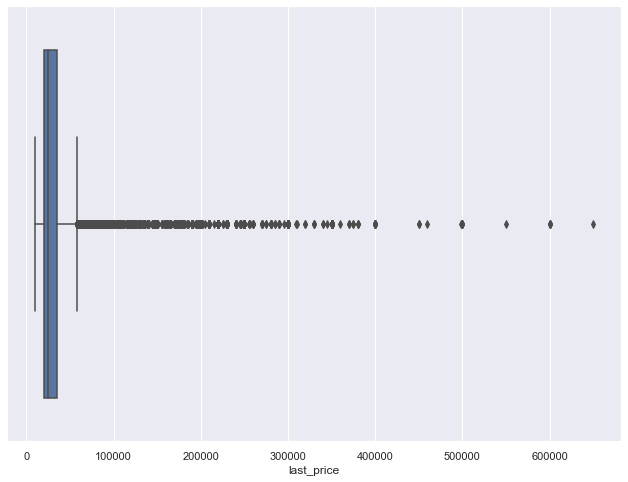

In [65]:
sns.set(rc={'figure.figsize':(11, 8)}) 
sns.boxplot(x=rent_df_cleaned_spb['last_price'])

In [66]:
rent_df_cleaned_spb['last_price'].quantile(0.997)

200000.0

In [67]:
rent_df_cleaned_spb = rent_df_cleaned_spb[rent_df_cleaned_spb['last_price']<200000]

In [68]:
rent_df_cleaned_spb.shape

(155392, 19)

In [69]:
rent_df_cleaned_spb.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 155392 entries, 0 to 171185
Data columns (total 19 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   offer_id                155392 non-null  int64  
 1   first_day_exposition    155392 non-null  object 
 2   last_day_exposition     155392 non-null  object 
 3   last_price              155392 non-null  float64
 4   floor                   155392 non-null  int64  
 5   open_plan               155392 non-null  bool   
 6   rooms                   155392 non-null  int64  
 7   studio                  155392 non-null  bool   
 8   area                    155392 non-null  float64
 9   kitchen_area            118364 non-null  float64
 10  living_area             123015 non-null  float64
 11  agent_fee               122840 non-null  float64
 12  renovation              102677 non-null  float64
 13  offer_type              155392 non-null  int64  
 14  category_type       

In [70]:
rent_df_cleaned_spb.isna().sum()

offer_id                      0
first_day_exposition          0
last_day_exposition           0
last_price                    0
floor                         0
open_plan                     0
rooms                         0
studio                        0
area                          0
kitchen_area              37028
living_area               32377
agent_fee                 32552
renovation                52715
offer_type                    0
category_type                 0
unified_address               0
building_id                   0
price_per_sq_m                0
house_price_sqm_median        0
dtype: int64

In [71]:
# we can see that we have missing values (at further steps, before modelling, we should fill them or exclude vars)
(rent_df_cleaned_spb.isna().sum() / len(rent_df_cleaned_spb)).rename('percent of NA').to_frame().style.bar(vmax=1, vmin=0).format('{:.2%}')

,percent of NA
offer_id,0.00%
first_day_exposition,0.00%
last_day_exposition,0.00%
last_price,0.00%
floor,0.00%
open_plan,0.00%
rooms,0.00%
studio,0.00%
area,0.00%
kitchen_area,23.83%


In [75]:
pd.options.plotting.backend = "plotly"
rent_df_cleaned_spb.last_price.hist()

<AxesSubplot:xlabel='last_price'>

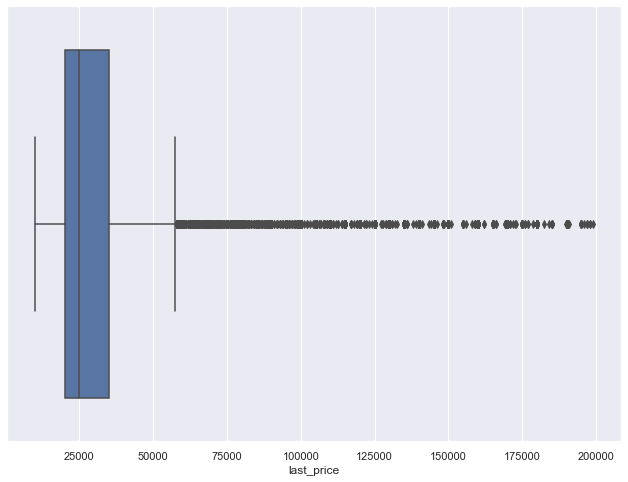

In [73]:
sns.set(rc={'figure.figsize':(11, 8)}) 
sns.boxplot(x=rent_df_cleaned_spb['last_price'])

In [197]:
pd.options.plotting.backend = "plotly"
rent_df_cleaned_spb.price_per_sq_m.hist()

In [198]:
rent_df_cleaned_spb.drop(columns=['category_type','offer_type', 'building_id'], inplace=True)

/var/folders/_9/hdzs3fj92gz4h7c3jw2hrc6m0000gn/T/ipykernel_44709/3167569922.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [199]:
# Let's further clean data
rent_df_cleaned_spb.drop(columns=['offer_id','price_per_sq_m','house_price_sqm_median'], inplace=True)

/var/folders/_9/hdzs3fj92gz4h7c3jw2hrc6m0000gn/T/ipykernel_44709/2018957123.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [200]:
rent_df_cleaned_spb['open_plan'] = rent_df_cleaned_spb['open_plan'].astype('int')
rent_df_cleaned_spb['studio'] = rent_df_cleaned_spb['studio'].astype('int')

/var/folders/_9/hdzs3fj92gz4h7c3jw2hrc6m0000gn/T/ipykernel_44709/930033456.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_9/hdzs3fj92gz4h7c3jw2hrc6m0000gn/T/ipykernel_44709/930033456.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



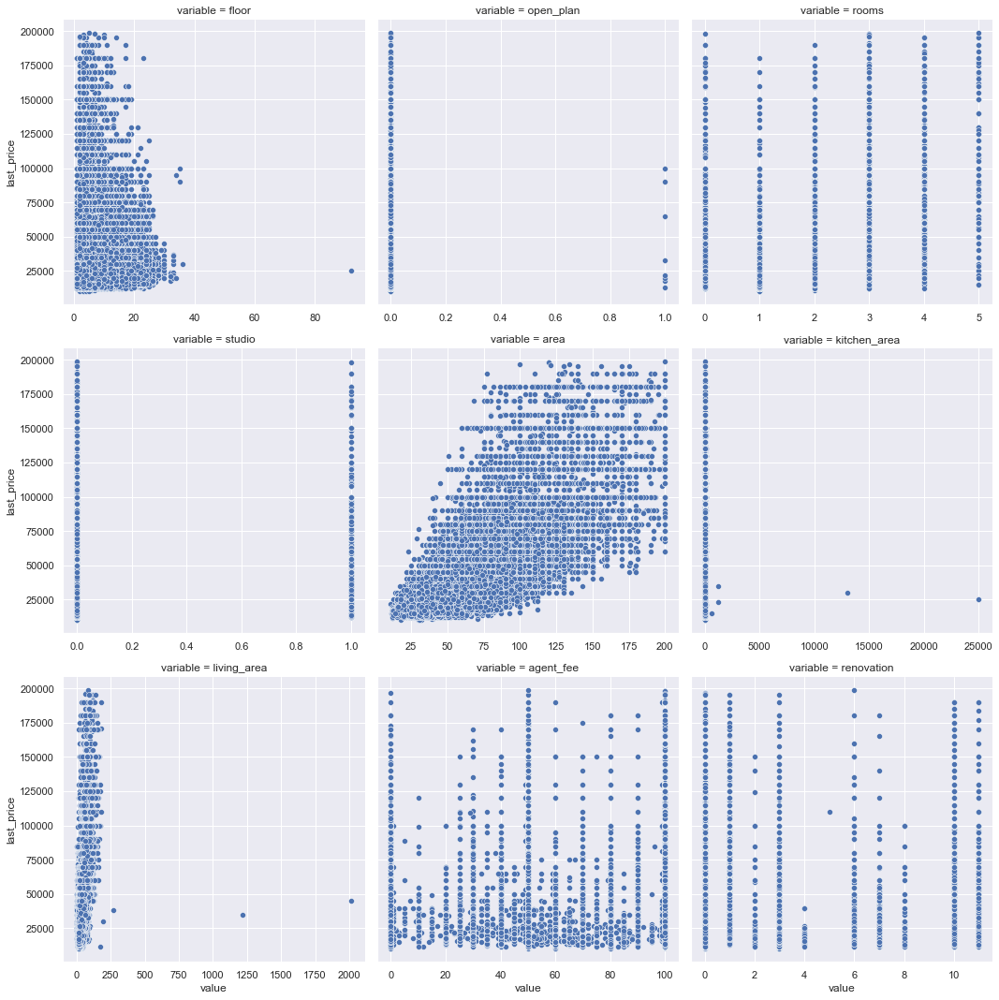

In [201]:
sns.relplot(data=rent_df_cleaned_spb.select_dtypes('number').melt(id_vars=['last_price']),
            x='value', y='last_price', col='variable', col_wrap=3, 
            facet_kws=dict(sharex=False)
           )

In [202]:
rent_df_cleaned_spb.head()

,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,unified_address
0,2015-01-24T00:00:00+03:00,2016-01-19T00:00:00+03:00,20000.0,7,0,1,0,28.0,8.0,20.0,100.0,3.0,"Россия, Санкт-Петербург, Богатырский проспект, 5к1"
1,2015-11-17T00:00:00+03:00,2016-03-04T00:00:00+03:00,24000.0,4,0,2,0,59.0,10.0,35.0,100.0,3.0,"Россия, Санкт-Петербург, Богатырский проспект, 5к1"
2,2015-11-17T00:00:00+03:00,2016-04-24T00:00:00+03:00,18000.0,6,0,1,0,36.0,9.0,17.0,100.0,3.0,"Россия, Санкт-Петербург, Богатырский проспект, 5к1"
3,2016-02-04T00:00:00+03:00,2016-02-28T00:00:00+03:00,18000.0,8,0,1,0,39.0,10.0,18.0,90.0,0.0,"Россия, Санкт-Петербург, Богатырский проспект, 5к1"
4,2016-02-28T00:00:00+03:00,2016-04-02T00:00:00+03:00,19000.0,3,0,1,0,36.0,8.0,18.0,50.0,11.0,"Россия, Санкт-Петербург, Богатырский проспект, 5к1"


<AxesSubplot:>

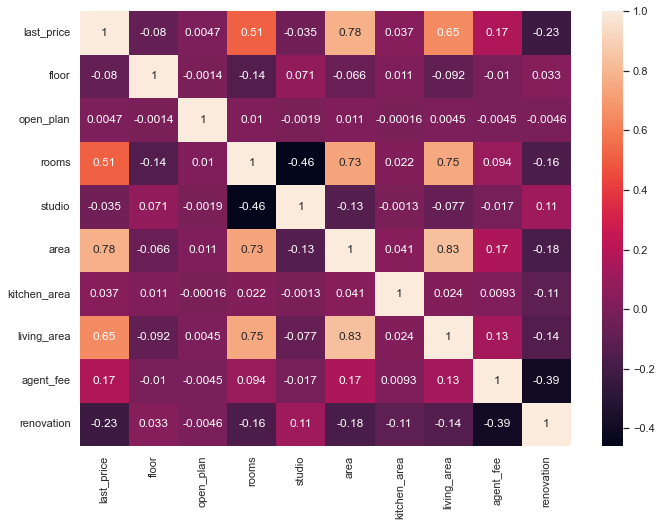

In [203]:
import scipy
sns.heatmap(rent_df_cleaned_spb.corr(),annot=True)

In [204]:
rent_df_cleaned_spb.describe()

,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation
count,155392.000000,155392.000000,155392.000000,155392.000000,155392.000000,155392.000000,118364.000000,123015.000000,122840.000000,102677.000000
mean,31889.961349,6.698498,0.000051,1.599297,0.063768,53.358246,11.597837,30.419019,71.925965,3.696592
std,20303.545282,4.978305,0.007175,0.872410,0.244340,24.097810,82.238109,17.405261,28.424895,4.489441
min,9990.000000,1.000000,0.000000,0.000000,0.000000,11.000000,2.000000,2.000000,0.000000,0.000000
25%,20000.000000,3.000000,0.000000,1.000000,0.000000,38.000000,8.000000,18.000000,50.000000,0.000000
50%,25000.000000,5.000000,0.000000,1.000000,0.000000,46.000000,10.000000,27.000000,70.000000,1.000000
75%,35000.000000,9.000000,0.000000,2.000000,0.000000,62.000000,12.000000,37.000000,100.000000,10.000000
max,199000.000000,92.000000,1.000000,5.000000,1.000000,200.000000,25000.000000,2015.000000,100.000000,11.000000


In [205]:
rent_df_cleaned_spb.drop(columns=['kitchen_area','living_area'], inplace=True)

/var/folders/_9/hdzs3fj92gz4h7c3jw2hrc6m0000gn/T/ipykernel_44709/4149612721.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [206]:
#unified_address = rent_df_cleaned_spb.pop('unified_address')

In [207]:
rent_df_cleaned_spb.head()

,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,agent_fee,renovation,unified_address
0,2015-01-24T00:00:00+03:00,2016-01-19T00:00:00+03:00,20000.0,7,0,1,0,28.0,100.0,3.0,"Россия, Санкт-Петербург, Богатырский проспект, 5к1"
1,2015-11-17T00:00:00+03:00,2016-03-04T00:00:00+03:00,24000.0,4,0,2,0,59.0,100.0,3.0,"Россия, Санкт-Петербург, Богатырский проспект, 5к1"
2,2015-11-17T00:00:00+03:00,2016-04-24T00:00:00+03:00,18000.0,6,0,1,0,36.0,100.0,3.0,"Россия, Санкт-Петербург, Богатырский проспект, 5к1"
3,2016-02-04T00:00:00+03:00,2016-02-28T00:00:00+03:00,18000.0,8,0,1,0,39.0,90.0,0.0,"Россия, Санкт-Петербург, Богатырский проспект, 5к1"
4,2016-02-28T00:00:00+03:00,2016-04-02T00:00:00+03:00,19000.0,3,0,1,0,36.0,50.0,11.0,"Россия, Санкт-Петербург, Богатырский проспект, 5к1"


In [208]:
rent_df_cleaned_spb.to_csv('cleaned_dataset.csv', index=False)

In [83]:
# Apartments for SELL
# let's check median and price for selling apartments
sell_median_price = sell_df.last_price.median()
sell_mean_price = sell_df.last_price.mean()
print("Sell median price: {}".format(rent_median_price))
print("Sell mean price: {}".format(rent_mean_price))

Sell median price: 25000.0
Sell mean price: 32605.087189685033


In [84]:
max_price_sell = sell_df.last_price.max()
print("Max price in sell: {}".format(max_price_sell))

Max price in sell: 763000000.0


In [85]:
#let's consider only SPb data of apartments for sell
sell_df_spb = sell_df[sell_df.unified_address.str.contains('Россия, Санкт-Петербург')].copy()
print("Sell data size in city limits: {}".format(len(sell_df_spb)))

Sell data size in city limits: 197792


In [86]:
# let's check median and price for selling apartments
rent_median_price = sell_df_spb.last_price.median()
rent_mean_price = sell_df_spb.last_price.mean()
print("Sell median price: {}".format(rent_median_price))
print("Sell mean price: {}".format(rent_mean_price))

Sell median price: 5300000.0
Sell mean price: 8151204.698728967


<AxesSubplot:xlabel='last_price'>

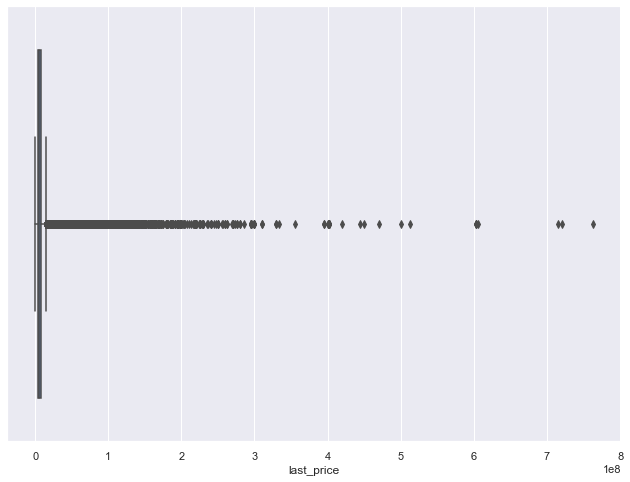

In [87]:
# For identifying outliers let's combine EDA & logic of previous steps for rent, but now for sell
sns.set(rc={'figure.figsize':(11, 8)}) 
sns.boxplot(x=sell_df_spb['last_price'])

In [88]:
pd.options.plotting.backend = "plotly"
sell_df_spb.last_price.hist()

In [89]:
sell_df_spb['last_price'].quantile(0.997)

102460000.0

In [90]:
len(sell_df_spb[(sell_df_spb.last_price > 102460000)])

593

In [91]:
# calculate price per sq m
sell_df_spb['price_per_sq_m'] = sell_df.last_price/sell_df.area

In [92]:
# find median price per sq m
house_sell_df_spb = sell_df_spb.groupby('unified_address').price_per_sq_m.median().reset_index()
house_sell_df_spb.rename(columns = {'price_per_sq_m': 'house_price_sqm_median'}, inplace = True)

In [93]:
# merge sell data with house median prices and inspect outliers
sell_df_spb = sell_df_spb.merge(house_sell_df_spb)

In [94]:
sell_df_spb.describe()

,offer_id,last_price,floor,rooms,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,building_id,price_per_sq_m,house_price_sqm_median
count,1.977920e+05,1.977920e+05,197792.000000,197792.000000,197792.000000,168799.000000,179219.000000,13142.000000,142614.000000,197792.0,197792.0,1.977920e+05,1.977920e+05,1.977920e+05
mean,4.930802e+18,8.151205e+06,6.721783,2.024404,64.625235,11.937120,36.192785,19.687986,3.467640,1.0,2.0,4.604822e+18,1.136452e+05,1.115236e+05
std,2.743008e+18,1.283477e+07,5.381079,1.166640,40.617352,7.153193,24.297953,39.441258,3.944312,0.0,0.0,2.732627e+18,6.322742e+04,4.578424e+04
min,7.797270e+05,1.900000e+04,1.000000,0.000000,6.000000,1.040000,1.640000,0.000000,0.000000,1.0,2.0,4.585730e+14,4.871795e+02,5.000000e+03
25%,2.554639e+18,3.900000e+06,3.000000,1.000000,40.200000,8.000000,19.000000,0.000000,0.000000,1.0,2.0,2.179036e+18,8.714286e+04,8.885749e+04
50%,5.283731e+18,5.300000e+06,5.000000,2.000000,55.000000,10.200000,31.000000,0.000000,2.000000,1.0,2.0,4.727029e+18,1.022857e+05,1.013889e+05
75%,7.278733e+18,8.200000e+06,9.000000,3.000000,76.400000,13.900000,44.000000,1.000000,6.000000,1.0,2.0,6.919866e+18,1.230101e+05,1.203704e+05
max,9.223371e+18,7.630000e+08,88.000000,22.000000,1000.000000,174.000000,710.000000,100.000000,14.000000,1.0,2.0,9.220297e+18,9.283388e+06,1.818182e+06


In [95]:
outliers = sell_df_spb[(sell_df_spb.price_per_sq_m/sell_df_spb.house_price_sqm_median) > 5]

In [96]:
print(len(outliers))

39


In [97]:
outliers.sample(10)

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
161988,6543132636567265536,2017-08-07T00:00:00+03:00,2017-09-21T00:00:00+03:00,285000000.0,1,False,1,False,30.70,6.5,17.5,NaN,7.0,1,2,"Россия, Санкт-Петербург, проспект Космонавтов, 48к3",9137473764455367897,9.283388e+06,100274.725275
106863,2029365665568947713,2018-06-24T00:00:00+03:00,2018-08-20T00:00:00+03:00,35000000.0,1,False,2,False,51.00,7.0,28.0,NaN,2.0,1,2,"Россия, Санкт-Петербург, Колпино, Заводской проспект, 18",1549642848657229329,6.862745e+05,66608.539765
139313,6353787954420231936,2018-07-21T00:00:00+03:00,2018-08-20T00:00:00+03:00,280000000.0,2,False,3,False,150.00,16.0,110.0,NaN,NaN,1,2,"Россия, Санкт-Петербург, 12-я Красноармейская улица, 6",6204918944542168629,1.866667e+06,89193.825043
3841,244178420220903124,2016-09-12T00:00:00+03:00,2017-03-24T00:00:00+03:00,444823936.0,6,False,2,False,88.50,20.0,53.5,NaN,0.0,1,2,"Россия, Санкт-Петербург, Конногвардейский бульвар, 5",8043782038424496855,5.026259e+06,400914.962325
174720,5152210162991259328,2017-01-25T00:00:00+03:00,2017-09-04T00:00:00+03:00,80000000.0,1,False,3,False,79.00,10.0,55.0,NaN,0.0,1,2,"Россия, Санкт-Петербург, Гаванская улица, 7",6399847288779934223,1.012658e+06,107526.881720
126839,7848053552293849344,2018-07-14T00:00:00+03:00,2018-08-20T00:00:00+03:00,48999000.0,1,False,1,False,47.00,23.0,8.0,NaN,3.0,1,2,"Россия, Санкт-Петербург, Лахтинская улица, 18",7321902868942364572,1.042532e+06,122312.500000
50379,6100340951674067803,2017-08-03T00:00:00+03:00,2018-02-11T00:00:00+03:00,14986000.0,14,False,1,False,22.00,7.0,15.0,NaN,NaN,1,2,"Россия, Санкт-Петербург, проспект Энгельса, 93",274701856355833106,6.811818e+05,125000.000000
87650,7195375218410563072,2017-11-28T00:00:00+03:00,2018-08-02T00:00:00+03:00,118000000.0,2,False,3,False,98.30,12.5,51.0,NaN,NaN,1,2,"Россия, Санкт-Петербург, Киевская улица, 6",601237935667676085,1.200407e+06,158298.246523
121718,5902825275847175680,2016-03-24T00:00:00+03:00,2016-06-22T00:00:00+03:00,34000000.0,10,False,1,False,40.40,NaN,14.0,NaN,11.0,1,2,"Россия, Санкт-Петербург, переулок Гривцова, 6",6312852829589816564,8.415842e+05,99509.803922
162145,5592490235564366445,2018-08-15T00:00:00+03:00,2018-08-20T00:00:00+03:00,57120000.0,27,False,2,False,57.64,10.2,28.7,NaN,NaN,1,2,"Россия, Санкт-Петербург, посёлок Парголово, улица Валерия Гаврилина, 13к1",6231591702518760702,9.909785e+05,93195.266272


In [98]:
sell_df_spb_cleaned = sell_df_spb[~((sell_df_spb.price_per_sq_m/sell_df_spb.house_price_sqm_median) > 5)]

In [99]:
# look at offers with price > 0.997 quantile
sell_df_spb_cleaned[(sell_df_spb_cleaned.last_price >= 102460000)]

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
1288,5028522700589824838,2014-11-27T00:00:00+03:00,2016-06-04T00:00:00+03:00,129641000.0,5,False,2,False,242.9,14.20,200.8,NaN,0.0,1,2,"Россия, Санкт-Петербург, Аптекарский переулок, 4",3756270137055046483,533721.696171,215251.156642
1792,5153034022899540930,2017-10-19T00:00:00+03:00,2018-04-22T00:00:00+03:00,180000000.0,4,False,14,False,631.2,40.00,200.0,NaN,NaN,1,2,"Россия, Санкт-Петербург, Шпалерная улица, 26",2374209456465592191,285171.102662,125000.000000
2886,5028522699968447192,2014-12-09T00:00:00+03:00,2016-09-01T00:00:00+03:00,104750000.0,7,False,4,False,209.5,19.20,117.8,NaN,0.0,1,2,"Россия, Санкт-Петербург, проспект Динамо, 6",135575281136523355,500000.000000,409846.153846
2887,4159557122221147750,2015-02-20T00:00:00+03:00,2016-05-15T00:00:00+03:00,120252000.0,3,False,4,False,273.0,24.78,167.1,NaN,0.0,1,2,"Россия, Санкт-Петербург, проспект Динамо, 6",135575281136523355,440483.516484,409846.153846
2888,5028522704291329800,2014-12-09T00:00:00+03:00,2016-04-21T00:00:00+03:00,120252000.0,3,False,4,False,273.3,24.80,162.4,NaN,0.0,1,2,"Россия, Санкт-Петербург, проспект Динамо, 6",135575281136523355,440000.000000,409846.153846
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195447,8310251212144422507,2018-07-03T00:00:00+03:00,2018-08-20T00:00:00+03:00,119900000.0,3,False,7,False,280.0,40.00,160.0,0.0,NaN,1,2,"Россия, Санкт-Петербург, набережная Кутузова, 24",7246731949853653443,428214.285714,428392.857143
195449,5535692837358266692,2018-07-12T00:00:00+03:00,2018-08-20T00:00:00+03:00,120000000.0,3,False,5,False,280.0,30.00,162.0,NaN,NaN,1,2,"Россия, Санкт-Петербург, набережная Кутузова, 24",7246731949853653443,428571.428571,428392.857143
195450,5535692837358266659,2018-07-19T00:00:00+03:00,2018-08-20T00:00:00+03:00,159000000.0,3,False,3,False,440.0,NaN,136.0,NaN,NaN,1,2,"Россия, Санкт-Петербург, набережная Кутузова, 24",7246731949853653443,361363.636364,428392.857143
195451,1312747617989515616,2018-08-07T00:00:00+03:00,2018-08-20T00:00:00+03:00,105000000.0,4,False,4,False,194.0,20.00,119.0,NaN,NaN,1,2,"Россия, Санкт-Петербург, набережная Кутузова, 24",7246731949853653443,541237.113402,428392.857143


In [100]:
# let's remove anomally big (very high) prices
sell_df_spb_cleaned = sell_df_spb_cleaned[sell_df_spb_cleaned.last_price < 102460000]

In [101]:
# let's examine apartments with big price per sq m
# we can already see some suspitious observations (with too smal areas and large prices, e.g #197140 with area of 6
# in not prestigios area)
sell_df_spb_cleaned[sell_df_spb_cleaned.price_per_sq_m > 300000]

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
681,5028522704286794693,2014-12-09T00:00:00+03:00,2016-09-11T00:00:00+03:00,53300000.0,11,False,3,False,151.4,17.10,57.00,NaN,0.0,1,2,"Россия, Санкт-Петербург, Приморский проспект, 52к1",1218123990061227879,3.520476e+05,1.513624e+05
845,5028522700621138124,2016-07-22T00:00:00+03:00,2017-01-09T00:00:00+03:00,34029000.0,10,False,3,False,103.4,17.44,75.00,NaN,0.0,1,2,"Россия, Санкт-Петербург, Приморский проспект, 52к1",1218123990061227879,3.291006e+05,1.513624e+05
847,5028522700621138091,2016-07-23T00:00:00+03:00,2017-01-09T00:00:00+03:00,37191000.0,12,False,4,False,115.3,10.14,68.80,NaN,0.0,1,2,"Россия, Санкт-Петербург, Приморский проспект, 52к1",1218123990061227879,3.225585e+05,1.513624e+05
853,7623901081917621401,2015-12-19T00:00:00+03:00,2016-09-09T00:00:00+03:00,36590000.0,10,False,2,False,103.4,NaN,NaN,NaN,0.0,1,2,"Россия, Санкт-Петербург, Приморский проспект, 52к1",1218123990061227879,3.538685e+05,1.513624e+05
934,4617947929268943918,2014-11-27T00:00:00+03:00,2017-02-17T00:00:00+03:00,38990000.0,12,False,3,False,117.0,26.60,56.70,NaN,6.0,1,2,"Россия, Санкт-Петербург, Приморский проспект, 52к1",1218123990061227879,3.332479e+05,1.513624e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
197069,4829394877221044770,2018-05-19T00:00:00+03:00,2018-08-20T00:00:00+03:00,60213472.0,11,False,3,False,200.3,32.10,101.00,NaN,NaN,1,2,"Россия, Санкт-Петербург, Пионерская улица, 5/20",7651831335807888863,3.006164e+05,3.026800e+05
197070,5511293275419583654,2018-05-19T00:00:00+03:00,2018-08-20T00:00:00+03:00,79786448.0,12,False,4,False,263.6,15.29,134.93,NaN,NaN,1,2,"Россия, Санкт-Петербург, Пионерская улица, 5/20",7651831335807888863,3.026800e+05,3.026800e+05
197071,4829394877221044769,2018-02-21T00:00:00+03:00,2018-08-20T00:00:00+03:00,81863120.0,12,False,3,False,250.3,31.73,101.54,NaN,NaN,1,2,"Россия, Санкт-Петербург, Пионерская улица, 5/20",7651831335807888863,3.270600e+05,3.026800e+05
197140,2813360794962873345,2018-07-13T00:00:00+03:00,2018-07-17T00:00:00+03:00,9999999.0,6,False,1,False,6.0,NaN,NaN,NaN,NaN,1,2,"Россия, Санкт-Петербург, Антоновская улица, 3",7422762128480584443,1.666666e+06,1.666666e+06


In [102]:
# apartment price on Kazanskaya looks reasonable, but overall, other apartments seem strange, let's remove them
sell_df_spb_cleaned[(sell_df_spb_cleaned.area < 20) & (sell_df_spb_cleaned.price_per_sq_m > 300000)]

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
10524,8270836302475801856,2018-07-25T00:00:00+03:00,2018-08-01T00:00:00+03:00,8000000.0,1,False,1,False,15.00,NaN,10.0,NaN,3.0,1,2,"Россия, Санкт-Петербург, Казанская улица, 8-10",4550908310222326344,5.333333e+05,1.243094e+05
44344,8088261018132859712,2016-04-06T00:00:00+03:00,2016-07-14T00:00:00+03:00,5800000.0,4,False,1,False,18.55,12.5,12.5,NaN,0.0,1,2,"Россия, Санкт-Петербург, проспект Медиков, 10к1",3661650946565906323,3.126685e+05,1.466860e+05
49762,7384194925148758017,2018-05-18T00:00:00+03:00,2018-08-20T00:00:00+03:00,5300000.0,8,False,3,False,16.10,10.7,12.9,NaN,NaN,1,2,"Россия, Санкт-Петербург, улица Пограничника Гарькавого, 33",6173452053034858293,3.291925e+05,8.478747e+04
63290,8027481297816103425,2018-02-10T00:00:00+03:00,2018-03-27T00:00:00+03:00,4000000.0,3,False,2,False,10.00,NaN,NaN,NaN,NaN,1,2,"Россия, Санкт-Петербург, проспект Культуры, 29к1",3550571368450211610,4.000000e+05,9.411765e+04
154922,4108699179660617729,2018-04-25T00:00:00+03:00,2018-07-24T00:00:00+03:00,21300000.0,2,False,0,True,15.00,NaN,12.0,NaN,11.0,1,2,"Россия, Санкт-Петербург, Бронницкая улица, 27",5973191840232289745,1.420000e+06,7.648611e+05
155165,1629502367036526849,2016-06-20T00:00:00+03:00,2016-07-11T00:00:00+03:00,4700000.0,1,False,1,False,15.00,NaN,NaN,NaN,3.0,1,2,"Россия, Санкт-Петербург, поселок Лисий Нос, Дуговая улица, 4",424717229116295052,3.133333e+05,3.133333e+05
197140,2813360794962873345,2018-07-13T00:00:00+03:00,2018-07-17T00:00:00+03:00,9999999.0,6,False,1,False,6.00,NaN,NaN,NaN,NaN,1,2,"Россия, Санкт-Петербург, Антоновская улица, 3",7422762128480584443,1.666666e+06,1.666666e+06


In [103]:
sell_df_spb_cleaned = sell_df_spb_cleaned[~((sell_df_spb_cleaned.price_per_sq_m > 300000) 
                                     & ((sell_df_spb_cleaned.area < 20)))]

In [104]:
#let's check apartments with large areas but too low prices 
sell_df_spb_cleaned[(sell_df_spb_cleaned.area > 100) & (sell_df_spb_cleaned.price_per_sq_m < 10000)]

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
30666,2040641616563826176,2016-05-23T00:00:00+03:00,2016-06-15T00:00:00+03:00,4200000.0,5,False,1,False,431.0,11.0,18.0,NaN,10.0,1,2,"Россия, Санкт-Петербург, посёлок Парголово, улица Михаила Дудина, 23к1",4661483057276825143,9744.779582,98924.043436
30970,3528445278440227584,2016-09-02T00:00:00+03:00,2016-10-17T00:00:00+03:00,1400000.0,4,False,3,False,280.0,25.0,18.0,NaN,0.0,1,2,"Россия, Санкт-Петербург, Лиговский проспект, 44А",2861706125080801998,5000.000000,94166.794567
45824,2554474531251537152,2017-09-04T00:00:00+03:00,2017-09-12T00:00:00+03:00,3600000.0,2,False,2,False,448.0,5.9,30.9,NaN,0.0,1,2,"Россия, Санкт-Петербург, проспект Маршала Блюхера, 38к1",1696402849480525775,8035.714286,86556.673572
50518,5028522700596232011,2015-05-01T00:00:00+03:00,2016-08-03T00:00:00+03:00,1440000.0,3,False,8,False,224.6,17.9,13.2,NaN,0.0,1,2,"Россия, Санкт-Петербург, Гагаринская улица, 25",622550191830777612,6411.398041,96004.228330
59122,1343750548527438820,2017-06-07T00:00:00+03:00,2017-06-16T00:00:00+03:00,2300000.0,4,False,1,False,289.0,28.4,29.8,NaN,0.0,1,2,"Россия, Санкт-Петербург, улица Чехова, 4",580791690220049099,7958.477509,96612.903226
59791,1123464793335974913,2018-01-10T00:00:00+03:00,2018-02-01T00:00:00+03:00,1150000.0,1,False,6,False,150.0,15.0,15.0,NaN,3.0,1,2,"Россия, Санкт-Петербург, Английский проспект, 45",3516410107635365929,7666.666667,90902.597403
61212,7684699700069001217,2018-05-03T00:00:00+03:00,2018-06-21T00:00:00+03:00,1800000.0,3,False,7,False,300.0,26.0,28.0,NaN,3.0,1,2,"Россия, Санкт-Петербург, проспект Римского-Корсакова, 8/18",4835589773239616396,6000.000000,103853.307456
65263,3101165,2015-07-01T00:00:00+03:00,2016-02-07T00:00:00+03:00,1200000.0,10,False,1,False,134.0,12.0,27.0,NaN,7.0,1,2,"Россия, Санкт-Петербург, Брестский бульвар, 15",3064769595082876760,8955.223881,8955.223881
65812,3250776597444616193,2016-04-23T00:00:00+03:00,2016-04-28T00:00:00+03:00,1560000.0,5,False,4,False,197.0,15.0,18.0,NaN,0.0,1,2,"Россия, Санкт-Петербург, улица Стойкости, 36к1",132296357019531359,7918.781726,7918.781726
65813,5709288895787653377,2016-08-24T00:00:00+03:00,2016-10-08T00:00:00+03:00,1250000.0,4,False,0,True,197.1,NaN,118.7,NaN,0.0,1,2,"Россия, Санкт-Петербург, улица Стойкости, 36к1",132296357019531359,6341.958397,7918.781726


In [105]:
# we may notice that median prices per sq m are few times higher for them or just equal to price per sqm
# let's clean data
sell_df_spb_cleaned = sell_df_spb_cleaned[~((sell_df_spb_cleaned.house_price_sqm_median/sell_df_spb_cleaned.price_per_sq_m) > 5)]

In [106]:
sell_df_spb_cleaned = sell_df_spb_cleaned[~(sell_df_spb_cleaned.house_price_sqm_median == sell_df_spb_cleaned.price_per_sq_m)]

In [107]:
# check again. Much better
sell_df_spb_cleaned[(sell_df_spb_cleaned.area > 100) & (sell_df_spb_cleaned.price_per_sq_m < 10000)]

,offer_id,first_day_exposition,last_day_exposition,last_price,floor,open_plan,rooms,studio,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,unified_address,building_id,price_per_sq_m,house_price_sqm_median
65813,5709288895787653377,2016-08-24T00:00:00+03:00,2016-10-08T00:00:00+03:00,1250000.0,4,False,0,True,197.1,NaN,118.7,NaN,0.0,1,2,"Россия, Санкт-Петербург, улица Стойкости, 36к1",132296357019531359,6341.958397,7918.781726
153129,3679950742782893056,2016-05-29T00:00:00+03:00,2016-06-02T00:00:00+03:00,1400000.0,3,False,5,False,181.0,12.0,18.0,NaN,11.0,1,2,"Россия, Санкт-Петербург, улица Демьяна Бедного, 29",4211466254957472766,7734.806630,37441.783480


<AxesSubplot:xlabel='last_price'>

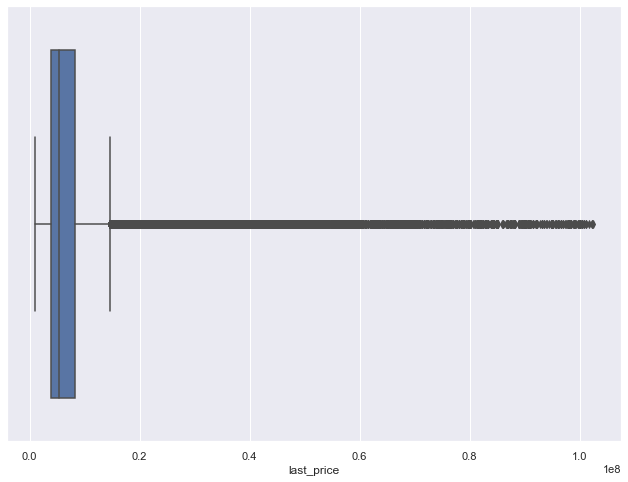

In [108]:
sns.set(rc={'figure.figsize':(11, 8)}) 
sns.boxplot(x=sell_df_spb_cleaned['last_price'])

In [109]:
pd.options.plotting.backend = "plotly"
sell_df_spb_cleaned.last_price.hist()

In [110]:
#let's check mean and median on cleaned data
sell_median_price = sell_df_spb_cleaned.last_price.median()
sell_mean_price = sell_df_spb_cleaned.last_price.mean()
print("Sell median price: {}".format(sell_median_price))
print("Sell mean price: {}".format(sell_mean_price))

Sell median price: 5300000.0
Sell mean price: 7700825.006998513


In [111]:
# EDA for SELL
# misssing values: agent_fee can be droppped further

In [112]:
sell_df_spb_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 182896 entries, 0 to 197767
Data columns (total 19 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   offer_id                182896 non-null  int64  
 1   first_day_exposition    182896 non-null  object 
 2   last_day_exposition     182896 non-null  object 
 3   last_price              182896 non-null  float64
 4   floor                   182896 non-null  int64  
 5   open_plan               182896 non-null  bool   
 6   rooms                   182896 non-null  int64  
 7   studio                  182896 non-null  bool   
 8   area                    182896 non-null  float64
 9   kitchen_area            155797 non-null  float64
 10  living_area             165596 non-null  float64
 11  agent_fee               12196 non-null   float64
 12  renovation              131549 non-null  float64
 13  offer_type              182896 non-null  int64  
 14  category_type       

In [113]:
sell_df_spb_cleaned.describe()

,offer_id,last_price,floor,rooms,area,kitchen_area,living_area,agent_fee,renovation,offer_type,category_type,building_id,price_per_sq_m,house_price_sqm_median
count,1.828960e+05,1.828960e+05,182896.000000,182896.000000,182896.000000,155797.000000,165596.000000,12196.000000,131549.000000,182896.0,182896.0,1.828960e+05,182896.000000,182896.000000
mean,4.942884e+18,7.700825e+06,6.902486,1.998043,63.675188,11.962701,35.584607,19.786402,3.467537,1.0,2.0,4.601467e+18,112629.572351,111119.252419
std,2.730191e+18,8.232415e+06,5.453786,1.143651,36.940179,6.836814,22.707680,39.516743,3.940633,0.0,0.0,2.734846e+18,46922.398497,42037.925123
min,7.797270e+05,1.000000e+06,1.000000,0.000000,10.000000,1.040000,1.640000,0.000000,0.000000,1.0,2.0,4.585730e+14,6341.958397,7918.781726
25%,2.554639e+18,3.900000e+06,3.000000,1.000000,40.000000,8.000000,18.950000,0.000000,0.000000,1.0,2.0,2.178893e+18,87500.000000,89160.839161
50%,5.283731e+18,5.300000e+06,5.000000,2.000000,55.000000,10.300000,30.800000,0.000000,2.000000,1.0,2.0,4.724026e+18,102756.892231,101772.810778
75%,7.258487e+18,8.200000e+06,9.000000,3.000000,76.000000,14.000000,44.000000,1.000000,6.000000,1.0,2.0,6.909065e+18,123480.000589,120547.945205
max,9.223371e+18,1.024560e+08,88.000000,22.000000,800.000000,120.000000,650.000000,100.000000,14.000000,1.0,2.0,9.220297e+18,870406.189555,759301.442673


In [114]:
(sell_df_spb_cleaned.isna().sum() / len(sell_df_spb_cleaned)).rename('percent of NA').to_frame().style.bar(vmax=1, vmin=0).format('{:.2%}')

,percent of NA
offer_id,0.00%
first_day_exposition,0.00%
last_day_exposition,0.00%
last_price,0.00%
floor,0.00%
open_plan,0.00%
rooms,0.00%
studio,0.00%
area,0.00%
kitchen_area,14.82%


In [115]:
#Let's further clean the dataset for sell
sell_df_spb_cleaned['open_plan'] = sell_df_spb_cleaned['open_plan'].astype('int')
sell_df_spb_cleaned['studio'] = sell_df_spb_cleaned['studio'].astype('int')
sell_df_spb_cleaned.drop(columns=['offer_id','price_per_sq_m','house_price_sqm_median', 
                                  'category_type','offer_type',
                                  'building_id'], inplace=True)

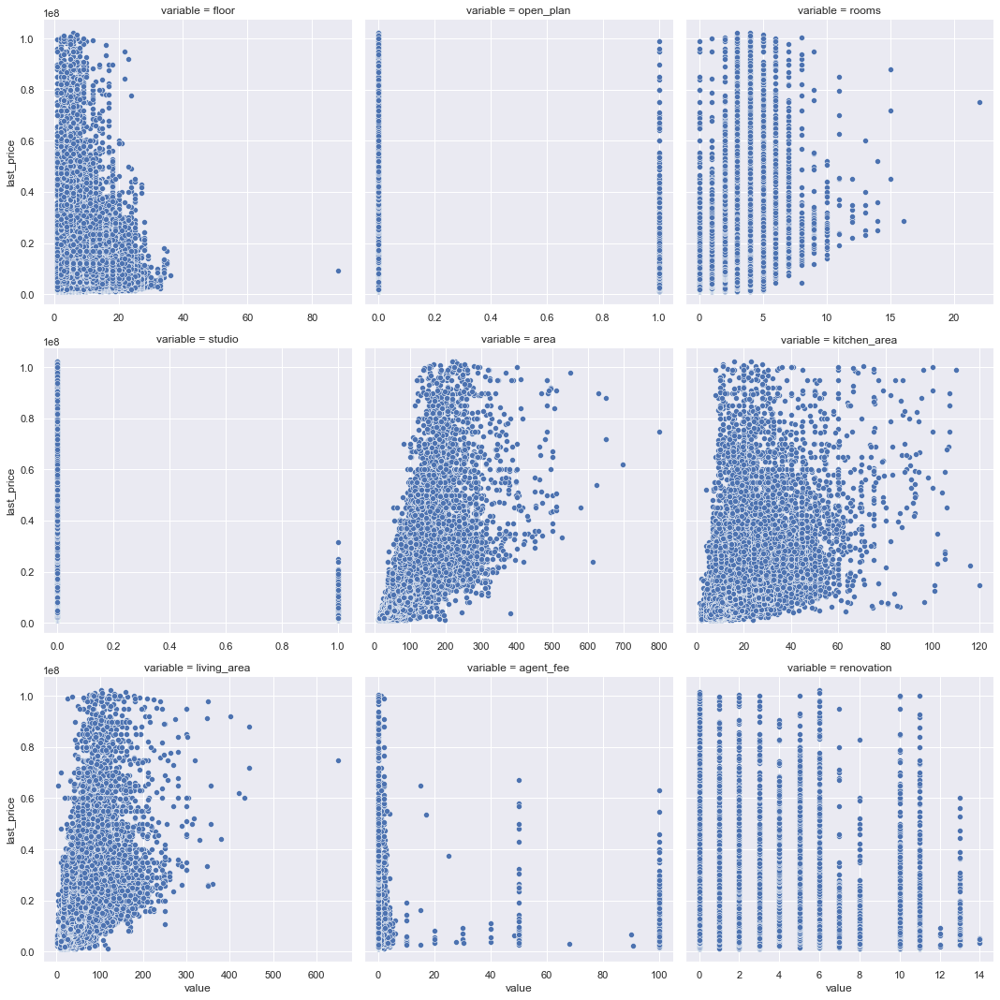

In [116]:
sns.relplot(data=sell_df_spb_cleaned.select_dtypes('number').melt(id_vars=['last_price']),
            x='value', y='last_price', col='variable', col_wrap=3, 
            facet_kws=dict(sharex=False)
           )

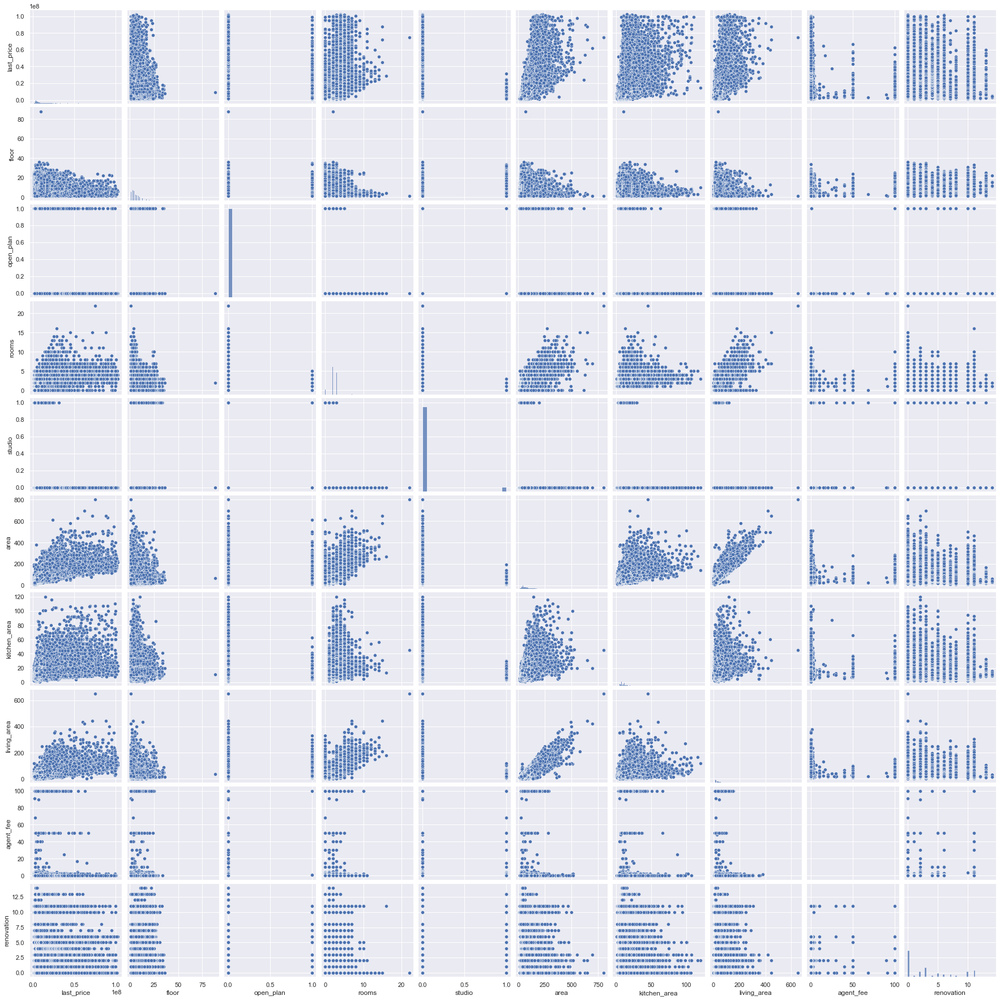

In [117]:
#pair plot to see more dependencies
sns.pairplot(sell_df_spb_cleaned.select_dtypes('number'))

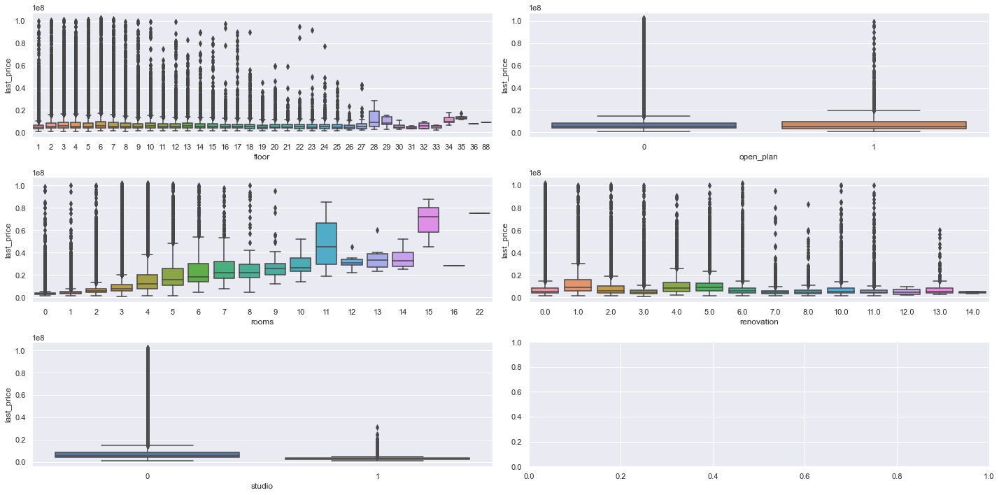

In [119]:
# analyzing categorical variables with scatterplots is OK, but let's do more comprehensive viz
categorical = ['floor','open_plan','rooms','renovation','studio']
fig, axes = plt.subplots(nrows=3,ncols=2, figsize = (20,10))
for idx, feat in enumerate(categorical):
    ax = axes[int(idx/2),idx%2]
    sns.boxplot(x=feat, y='last_price', data=sell_df_spb_cleaned, ax=ax)
    ax.set_xlabel(feat)
fig.tight_layout()

In [120]:
#drop column with a lot of missing values
sell_df_spb_cleaned.drop(columns=['agent_fee'], inplace=True)

<AxesSubplot:>

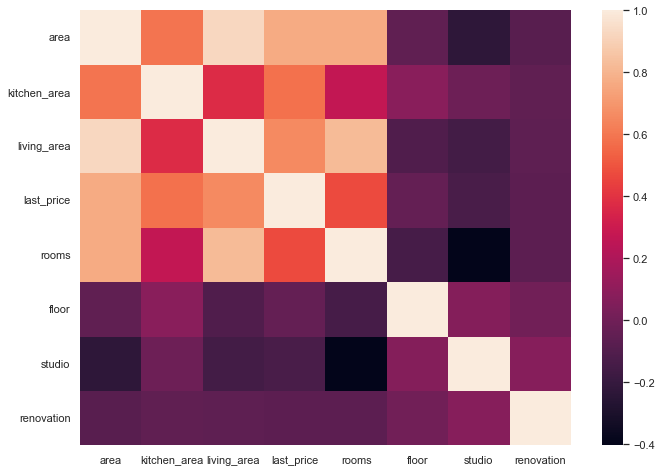

In [121]:
sns.heatmap(sell_df_spb_cleaned[['area','kitchen_area','living_area','last_price','rooms', 'floor', 'studio', 'renovation']].corr())

In [122]:
# also can skip living, kitchen area to avoid (consider only total area) multicollinearity in the model 
# we will further build + also we have missing values here
sell_df_spb_cleaned.drop(columns=['kitchen_area', 'living_area'], inplace=True)

In [123]:
# let's finish with Q5 on cleaned datasets
# for each apartment we buy we search median rent price of apartment in the house where we buy this apartment
# to make our calculation simple - we divide price of apatment by median rent price, round it in a big way -> 
# -> we get our repay period in months -> divide by 12 and get payback periond in years.
# we see that the most effective apartment is located on Vasilyevsky ostrov, 27 house and can be paid back in 1.5 years
house_median_rent_for_house = rent_df_cleaned_spb.groupby('unified_address').last_price.median().reset_index()
sell_df_spb_cleaned = sell_df_spb_cleaned.rename(columns = {
   "last_price": "price"})
new_df = sell_df_spb_cleaned.merge(house_median_rent_for_house)
new_df
new_df['n'] = (np.ceil(new_df.price/new_df.last_price))/12
final_new_df = new_df.sort_values(by=['n'], ascending=True)
final_new_df


,first_day_exposition,last_day_exposition,price,floor,open_plan,rooms,studio,area,renovation,unified_address,last_price,n
133349,2018-07-09T00:00:00+03:00,2018-08-20T00:00:00+03:00,2500000.0,2,0,0,1,18.00,3.0,"Россия, Санкт-Петербург, Средний проспект Васильевского острова, 27",140000.0,1.500000
23052,2018-08-14T00:00:00+03:00,2018-08-20T00:00:00+03:00,1755000.0,2,0,0,1,13.50,11.0,"Россия, Санкт-Петербург, улица Чехова, 11-13",100000.0,1.500000
60599,2018-07-29T00:00:00+03:00,2018-08-20T00:00:00+03:00,2730000.0,2,0,0,1,21.00,3.0,"Россия, Санкт-Петербург, проспект Чернышевского, 9",150000.0,1.583333
31373,2018-04-05T00:00:00+03:00,2018-05-20T00:00:00+03:00,2190000.0,1,0,0,1,16.82,NaN,"Россия, Санкт-Петербург, набережная реки Фонтанки, 75",120000.0,1.583333
133350,2018-07-28T00:00:00+03:00,2018-08-20T00:00:00+03:00,2800000.0,2,0,0,1,18.00,NaN,"Россия, Санкт-Петербург, Средний проспект Васильевского острова, 27",140000.0,1.666667
...,...,...,...,...,...,...,...,...,...,...,...,...
60454,2015-09-15T00:00:00+03:00,2017-09-30T00:00:00+03:00,100500000.0,7,0,3,0,156.00,0.0,"Россия, Санкт-Петербург, набережная реки Фонтанки, 76к2",17000.0,492.666667
60447,2017-01-13T00:00:00+03:00,2017-01-23T00:00:00+03:00,100518000.0,7,0,2,0,152.30,0.0,"Россия, Санкт-Петербург, набережная реки Фонтанки, 76к2",17000.0,492.750000
60427,2015-07-09T00:00:00+03:00,2016-08-01T00:00:00+03:00,101138000.0,6,0,3,0,165.80,0.0,"Россия, Санкт-Петербург, набережная реки Фонтанки, 76к2",17000.0,495.833333
60459,2017-07-10T00:00:00+03:00,2018-03-26T00:00:00+03:00,102178000.0,6,0,3,0,217.40,NaN,"Россия, Санкт-Петербург, набережная реки Фонтанки, 76к2",17000.0,500.916667


In [124]:
unified_address = rent_df_cleaned_spb.pop('unified_address')
unified_address = sell_df_spb_cleaned.pop('unified_address')